# Decarbonising Housing

In [1]:
from sqlalchemy import create_engine
import pandas as pd
import geopandas as gpd
import psycopg2
from psycopg2 import sql
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import folium
import os

# move current directory to /Users/tanyatsui/Documents/01_Projects/housingEmissions
os.chdir('/Users/tanyatsui/Documents/01_Projects/housingEmissions')

In [2]:
# create a connection to the database
db_name = 'urbanmining'
db_user = 'postgres'
db_password = 'Tunacompany5694!'
db_host = 'localhost'
db_port = '5432'
engine = create_engine(f'postgresql://{db_user}:{db_password}@{db_host}:{db_port}/{db_name}')


# Existing Housing emissions for the Netherlands (2012-2021)

### Yearly emissions - total, embodied, operational

In [3]:
query = ''' 
SELECT year, 
	SUM(construction*316) AS construction_emissions, SUM(renovation*126) AS renovation_emissions, 
	SUM(transformation*126) AS transformation_emissions, SUM(demolition*77) AS demolition_emissions, 
	SUM(tot_gas_m3*1.9) AS gas_emissions, SUM(tot_elec_kwh*0.45) AS electricity_emissions, 
	SUM(embodied_kg) AS embodied_kg, SUM(operational_kg) AS operational_kg, SUM(embodied_kg + operational_kg) AS total_kg
FROM emissions_all_buurt
GROUP BY year
'''
df = pd.read_sql_query(query, engine)

# px bar chart of embodied and operational emissions
fig = px.bar(df, x='year', y=['operational_kg', 'embodied_kg'], title='Housing emissions for the Netherlands (2012-2021)', 
             labels={'value':'kg CO2e', 'variable':'Emission Type', 'year':'Year'})
fig.update_layout(width=800)
fig.show()

# px bar chart of construction, renovation, transformation, and demolition emissions
fig = px.bar(df, x='year', y=['construction_emissions', 'renovation_emissions', 'transformation_emissions', 'demolition_emissions'], 
             title='Embodied emissions by building activity (2012-2021)', labels={'value':'kg CO2e', 'variable':'Emission Type', 'year':'Year'})
fig.update_layout(width=800)
fig.show()

# px bar chart of gas and electricity emissions
fig = px.bar(df, x='year', y=['gas_emissions', 'electricity_emissions'], title='Operational emissions by energy type (2012-2021)', 
             labels={'value':'kg CO2e', 'variable':'Energy Type', 'year':'Year'})
fig.update_layout(width=800)
fig.show()

In [4]:
total_tons = round(df['total_kg'].sum() / 1000000000, 2) # mtons 
avg_kg = round(df['total_kg'].mean() / 1000000000, 2) # mtons 

print(f'During the study period, the Netherlands produced {total_tons} Mtons of CO2e emissions from housing, with an average of {avg_kg} Mtons per year.')

During the study period, the Netherlands produced 317.57 Mtons of CO2e emissions from housing, with an average of 31.76 Mtons per year.


In [5]:
df_pie_embodied = df[['construction_emissions', 'renovation_emissions', 'transformation_emissions', 'demolition_emissions']].sum()
df_pie_embodied = df_pie_embodied.reset_index(name='kg_CO2e')

fig = px.pie(df_pie_embodied, values='kg_CO2e', names='index', title='Embodied emissions by building activity (2012-2021)')
fig.update_layout(width=600)
fig.show()

df_pie_operational = df[['gas_emissions', 'electricity_emissions']].sum()
df_pie_operational = df_pie_operational.reset_index(name='kg_CO2e')

fig = px.pie(df_pie_operational, values='kg_CO2e', names='index', title='Operational emissions by energy type (2012-2021)')
fig.update_layout(width=600)
fig.show()

In [6]:
query = ''' 
SELECT SUM(embodied_kg) AS embodied_kg, SUM(operational_kg) AS operational_kg, SUM(embodied_kg + operational_kg) AS total_kg
FROM emissions_all_buurt
'''

df = pd.read_sql_query(query, engine)

df_long = pd.melt(df, var_name='kg_type', value_name='kg')
df_long = df_long[df_long.kg_type != 'total_kg']

# plotly pie chart 
fig = px.pie(df_long, values='kg', names='kg_type', title='Total CO2 emissions by type')
fig.update_layout(width=500)
fig.show()

In [7]:
query = f''' 
    WITH stats_perbuurt_peryear AS (
        SELECT bu_code, year, n_homes,
            construction, renovation, transformation, demolition, inuse, 
            construction + renovation + transformation + demolition AS total_activity
        FROM buurt_stats
        WHERE n_homes > 0
    ), 
    stats_peryear AS (
        SELECT year, 
            SUM(n_homes) AS n_homes,
            SUM(construction) AS construction, SUM(renovation) AS renovation,
            SUM(transformation) AS transformation, SUM(demolition) AS demolition, 
            SUM(inuse) AS inuse, 
            SUM(construction + renovation + transformation + demolition) / SUM(inuse) * 100 AS p_building_activity, 
            SUM(construction) / SUM(inuse) * 100 AS p_construction,
            SUM(renovation) / SUM(inuse) * 100 AS p_renovation, 
            SUM(transformation) / SUM(inuse) * 100 AS p_transformation,
            SUM(demolition) / SUM(inuse) * 100 AS p_demolition, 
            SUM(construction) / SUM(total_activity) * 100 AS p_construction_activity,
            SUM(renovation) / SUM(total_activity) * 100 AS p_renovation_activity, 
            SUM(transformation) / SUM(total_activity) * 100 AS p_transformation_activity,
            SUM(demolition) / SUM(total_activity) * 100 AS p_demolition_activity
        FROM stats_perbuurt_peryear
        GROUP BY year 
    )

    SELECT a.*, a.n_homes - b.n_homes AS n_new_homes 
    FROM stats_peryear a 
    FULL JOIN stats_peryear b 
    ON a.year = b.year + 1 
    ''' 

stats_perYear = pd.read_sql_query(query, engine)

In [8]:
df = stats_perYear.copy()
print(f'Every year, the Netherlands alters on average {round(df.p_building_activity.mean(),2)}% of its building stock.')
print(f'{round(df.p_construction.mean(), 2)}% of the building stock is constructed,')
print(f'{round(df.p_renovation.mean(), 2)}% of the building stock is renovated,')
print(f'{round(df.p_transformation.mean(), 2)}% of the building stock is transformed, and')
print(f'{round(df.p_demolition.mean(), 2)}% of the building stock is demolished each year.')

print('\nEvery year, out of the total sqm of building activity in the Netherlands:')
print(f'{round(df.p_construction_activity.mean())}% is construction,')
print(f'{round(df.p_renovation_activity.mean())}% is renovation,')
print(f'{round(df.p_transformation_activity.mean())}% is transformation, and')
print(f'{round(df.p_demolition_activity.mean())}% is demolition.')

Every year, the Netherlands alters on average 1.46% of its building stock.
0.61% of the building stock is constructed,
0.46% of the building stock is renovated,
0.22% of the building stock is transformed, and
0.17% of the building stock is demolished each year.

Every year, out of the total sqm of building activity in the Netherlands:
42% is construction,
32% is renovation,
15% is transformation, and
12% is demolition.


In [9]:
print(f'Over the study period, ~{round(df.n_new_homes.sum()/1000)} thousand new homes were created,')
print(f'averaging ~{round(df.n_new_homes.mean()/1000)} thousand new homes per year.')

Over the study period, ~695 thousand new homes were created,
averaging ~77 thousand new homes per year.


### Comparing different buurts on a matrix

In [10]:
query = ''' 
WITH bu_stats_raw AS (
	SELECT bu_code, population, n_homes, 
		embodied_kg + operational_kg AS total_kg, 
		(embodied_kg + operational_kg) / population AS total_kg_per_capita, 
		(embodied_kg + operational_kg) / n_homes AS total_kg_per_home, 
		embodied_kg / n_homes AS embodied_per_home, 
		operational_kg / n_homes AS operational_per_home, 
        embodied_kg, operational_kg
	FROM emissions_all_buurt
	WHERE population > 0 AND n_homes > 0
		AND operational_kg / n_homes > 0 AND embodied_kg / n_homes > 0
), 
bu_stats AS (
	SELECT bu_code, 
		AVG(total_kg_per_capita) AS total_kg_per_capita, 
		AVG(total_kg_per_home) AS total_kg_per_home, 
		AVG(embodied_per_home) AS embodied_per_home, 
		AVG(operational_per_home) AS operational_per_home, 
		SUM(embodied_kg) AS embodied_kg,
		SUM(operational_kg) AS operational_kg, 
        AVG(n_homes) AS n_homes
	FROM bu_stats_raw 
	GROUP BY bu_code 
), 
bu_geoms AS (
	SELECT "BU_CODE" AS bu_code, "WK_CODE" AS wk_code, "GM_NAAM" AS municipality, 
		geometry AS bu_geom 
	FROM cbs_map_2022 
    WHERE "WATER" = 'NEE' 
)

SELECT a.*, b.bu_geom
FROM bu_stats a 
FULL JOIN bu_geoms b 
ON a.bu_code = b.bu_code 
'''

gdf = gpd.read_postgis(query, engine, geom_col='bu_geom')

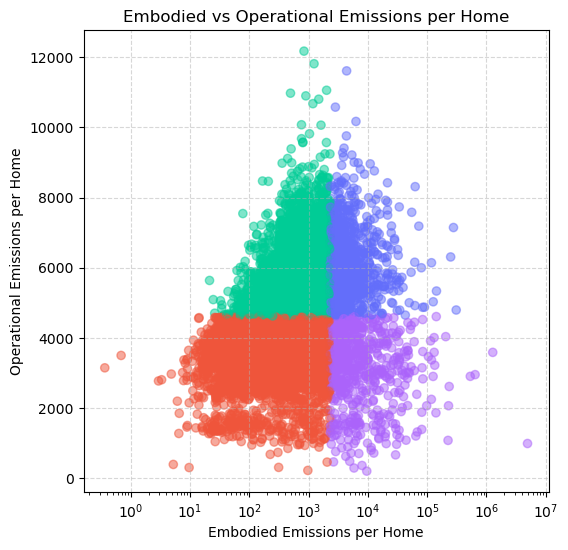

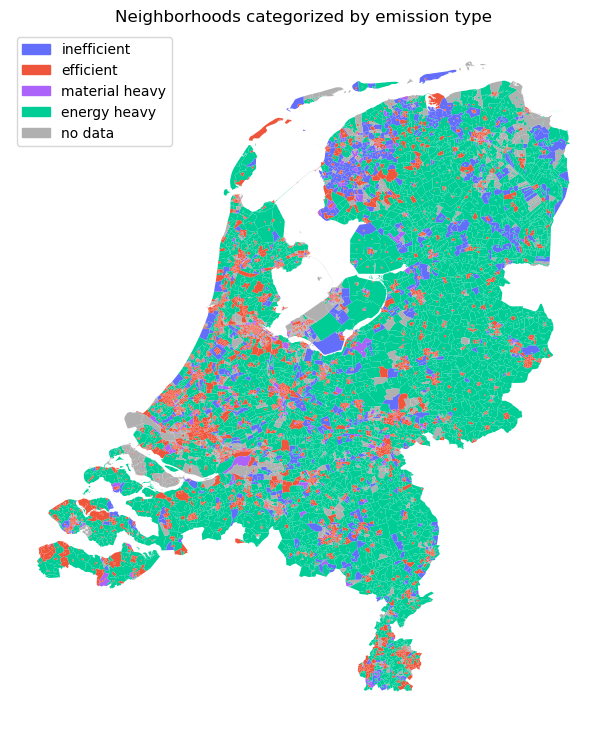

In [20]:
av_operational = gdf.operational_per_home.mean()
av_embodied = gdf.embodied_per_home.mean()
def classify_buurt(row): 
    operational_col = 'operational_per_home'
    embodied_col = 'embodied_per_home'
    if pd.isna(row[operational_col]) and pd.isna(row[embodied_col]):
        return 'no data'
    elif row[operational_col] > av_operational and row[embodied_col] > av_embodied: 
        return 'inefficient'
    elif row[operational_col] > av_operational and row[embodied_col] < av_embodied:
        return 'energy heavy'
    elif row[operational_col] < av_operational and row[embodied_col] > av_embodied:
        return 'material heavy'
    elif row[operational_col] < av_operational and row[embodied_col] < av_embodied:
        return 'efficient'
    else:
        return 'no data'
gdf['buurt_type'] = gdf.apply(lambda row: classify_buurt(row), axis=1)

color_dict = {
    'inefficient': '#636EFA', 
    'efficient': '#EF553B',
    'material heavy': '#AB63FA', 
    'energy heavy': '#00CC96', 
    'no data': '#B0B0B0' 
}
gdf['color'] = gdf['buurt_type'].map(color_dict)

# scatterplot 
plt.figure(figsize=(6, 6))
plt.scatter(gdf['embodied_per_home'], gdf['operational_per_home'], c=gdf['color'], alpha=0.5)
plt.xscale('log')
plt.xlabel('Embodied Emissions per Home')
plt.ylabel('Operational Emissions per Home')
plt.title('Embodied vs Operational Emissions per Home')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# map plot
fig, ax = plt.subplots(figsize=(15, 9))
gdf.plot(color=gdf['color'], legend=True, ax=ax, legend_kwds={'loc': 'center left', 'bbox_to_anchor': (1.8, 1)})
ax.set_axis_off()
legend_patches = [mpatches.Patch(color=color, label=label) for label, color in color_dict.items()]
ax.legend(handles=legend_patches, loc='upper left')
ax.set_title('Neighborhoods categorized by emission type')
plt.show()

### Boxplots - buurts

In [12]:
query = f''' 
    WITH stats_perbuurt_peryear AS (
        SELECT bu_code, year, 
            inuse, n_homes, inuse / n_homes AS home_size, 
            tot_gas_m3, tot_elec_kwh, 
            tot_gas_m3 / inuse AS gas_per_sqm, 
            tot_elec_kwh / inuse AS elec_per_sqm, 
            population, 
            population / n_homes AS n_people_per_home, 
            population / ST_Area(bu_geom) * 1000000 AS population_density,
            woz, av_build_year, 
            construction, renovation, transformation, demolition, 
            construction / inuse * 100 AS p_construction, 
            renovation / inuse * 100 AS p_renovation, 
            transformation / inuse * 100 AS p_transformation, 
            demolition / inuse * 100 AS p_demolition 
        FROM buurt_stats
        WHERE n_homes > 0
    ), 
    stats_perbuurt AS (
        SELECT bu_code, 
            AVG(inuse) AS inuse, AVG(n_homes) AS n_homes, AVG(home_size) AS home_size, AVG(av_build_year) AS av_build_year,
            SUM(tot_gas_m3) AS tot_gas_m3, SUM(tot_elec_kwh) AS tot_elec_kwh, 
            AVG(gas_per_sqm) AS gas_per_sqm, AVG(elec_per_sqm) AS elec_per_sqm, 
            AVG(n_people_per_home) AS n_people_per_home, AVG(woz) AS woz, 
            AVG(population) AS population, AVG(population_density) AS population_density,
            SUM(construction) AS construction, SUM(renovation) AS renovation, 
            SUM(transformation) AS transformation, SUM(demolition) AS demolition, 
            AVG(p_construction) AS p_construction, AVG(p_renovation) AS p_renovation, 
            AVG(p_transformation) AS p_transformation, AVG(p_demolition) AS p_demolition 
        FROM stats_perbuurt_peryear
        GROUP BY bu_code
        ORDER BY AVG(home_size)
    ), 
    n_homes_2012 AS (
        SELECT year, bu_code, n_homes 
        FROM buurt_stats 
        WHERE year = 2012 
    ), 
    n_homes_2021 AS (
        SELECT year, bu_code, n_homes
        FROM buurt_stats
        WHERE year = 2021 
    ), 
    n_new_homes AS (
        SELECT a.bu_code, b.n_homes - a.n_homes AS n_new_homes 
        FROM n_homes_2012 a 
        JOIN n_homes_2021 b 
        ON a.bu_code = b.bu_code 
    )

    SELECT a.*, b.n_new_homes
    FROM stats_perbuurt a 
    JOIN n_new_homes b 
    ON a.bu_code = b.bu_code 
    ''' 

stats_perBuurt = pd.read_sql_query(query, engine)

In [15]:
import plotly.express as px
import math
from plotly.subplots import make_subplots

# Define the color mapping for buurt_type
buurt_colors = {
    'efficient': '#EF553B',
    'energy heavy': '#00CC96',
    'material heavy': '#AB63FA',
    'inefficient': '#636EFA'
}

gdf_type_perBuurt = gdf.drop(columns='n_homes').merge(stats_perBuurt, on='bu_code')

# Define characteristics
# buurt_characteristics = ['inuse', 'n_homes', 'home_size', 'n_new_homes', 'av_build_year',
#                          'population_density', 'population', 'n_people_per_home', 'woz',
#                          'gas_per_sqm', 'elec_per_sqm', 
#                          'tot_gas_m3', 'tot_elec_kwh', 
#                          'construction', 'renovation', 'transformation', 'demolition']
buurt_characteristics = ['home_size', 'av_build_year', 'population_density', 'woz', 'n_new_homes']

# Calculate grid dimensions
n_cols = 6
n_rows = math.ceil(len(buurt_characteristics) / n_cols)

# Create a subplot figure with 4 plots per row
fig = make_subplots(rows=n_rows, cols=n_cols, 
                    subplot_titles=buurt_characteristics)

# Add each plot to the grid
df = gdf_type_perBuurt.copy()
for i, col_name in enumerate(buurt_characteristics):
    df_adjusted = df.copy()
    df_adjusted = df_adjusted[df_adjusted[col_name].notnull()]
    outliers_dict = {
        'home_size': ['<', 500],
        'gas_per_sqm': ['<', 40],
        'elec_per_sqm': ['<', 100],
        'n_people_per_home': ['<', 10], 
        'av_build_year': ['>', 1800]
    }
    if col_name in outliers_dict:
        if outliers_dict[col_name][0] == '<':
            df_adjusted = df_adjusted[df_adjusted[col_name] < outliers_dict[col_name][1]]
        elif outliers_dict[col_name][0] == '>':
            df_adjusted = df_adjusted[df_adjusted[col_name] > outliers_dict[col_name][1]]
    
    # Create a box plot with custom colors
    box_fig = px.box(df_adjusted, x='buurt_type', y=col_name, color='buurt_type',
                     color_discrete_map=buurt_colors)
    for trace in box_fig.data:
        row = (i // n_cols) + 1
        col = (i % n_cols) + 1
        fig.add_trace(trace, row=row, col=col)
        fig.update_yaxes(type='log', row=row, col=col)
        if col_name in ['av_build_year', 'n_people_per_home', 'woz', 'gas_per_sqm', 'elec_per_sqm']:
            fig.update_yaxes(type='linear', row=row, col=col)

# Update layout
fig.update_layout(height=400 * n_rows, width=1000, showlegend=False)
fig.show()


# Data for all scenarios

In [21]:
query = f''' 
WITH scenario_stats_raw AS (
	SELECT 
		municipality, bu_code, 

		-- embodied emissions stats 
		SUM(embodied_kg_s0) AS embodied_kg_s0, 
		SUM(embodied_kg_s1) AS embodied_kg_s1, 
		SUM(embodied_kg_s2) AS embodied_kg_s2, 
		SUM(embodied_kg_s3) AS embodied_kg_s3,
		SUM(embodied_kg_s1) - SUM(embodied_kg_s0) AS diff_embodied_s1, 
		SUM(embodied_kg_s2) - SUM(embodied_kg_s0) AS diff_embodied_s2, 
		SUM(embodied_kg_s3) - SUM(embodied_kg_s0) AS diff_embodied_s3,
		CASE 
			WHEN SUM(embodied_kg_s0) = 0 THEN 0
			ELSE ((SUM(embodied_kg_s1) - SUM(embodied_kg_s0)) / SUM(embodied_kg_s0)) * 100
		END AS diff_embodied_s1_pct, 
		CASE 
			WHEN SUM(embodied_kg_s0) = 0 THEN 0
			ELSE ((SUM(embodied_kg_s2) - SUM(embodied_kg_s0)) / SUM(embodied_kg_s0)) * 100
		END AS diff_embodied_s2_pct, 
		CASE 
			WHEN SUM(embodied_kg_s0) = 0 THEN 0
			ELSE ((SUM(embodied_kg_s3) - SUM(embodied_kg_s0)) / SUM(embodied_kg_s0)) * 100
		END AS diff_embodied_s3_pct,
        AVG(embodied_kg_s0 / n_homes) AS embodied_per_home,

		-- operational emissions stats 
		SUM(operational_kg_s0) AS operational_kg_s0, 
		SUM(operational_kg_s1) AS operational_kg_s1, 
		SUM(operational_kg_s2) AS operational_kg_s2, 
		SUM(operational_kg_s3) AS operational_kg_s3, 
		SUM(operational_kg_s1) - SUM(operational_kg_s0) AS diff_operational_s1, 
		SUM(operational_kg_s2) - SUM(operational_kg_s0) AS diff_operational_s2, 
		SUM(operational_kg_s3) - SUM(operational_kg_s0) AS diff_operational_s3,
		CASE 
			WHEN SUM(operational_kg_s0) = 0 THEN 0
			ELSE ((SUM(operational_kg_s1) - SUM(operational_kg_s0)) / SUM(operational_kg_s0)) * 100
		END AS diff_operational_s1_pct, 
		CASE 
			WHEN SUM(operational_kg_s0) = 0 THEN 0
			ELSE ((SUM(operational_kg_s2) - SUM(operational_kg_s0)) / SUM(operational_kg_s0)) * 100
		END AS diff_operational_s2_pct, 
		CASE 
			WHEN SUM(operational_kg_s0) = 0 THEN 0
			ELSE ((SUM(operational_kg_s3) - SUM(operational_kg_s0)) / SUM(operational_kg_s0)) * 100
		END AS diff_operational_s3_pct,
        AVG(operational_kg_s0 / n_homes) AS operational_per_home,

		-- total emissions stats 
		SUM(embodied_kg_s0) + SUM(operational_kg_s0) AS total_kg_s0, 
		SUM(embodied_kg_s1) + SUM(operational_kg_s1) AS total_kg_s1, 
		SUM(embodied_kg_s2) + SUM(operational_kg_s2) AS total_kg_s2, 
		SUM(embodied_kg_s3) + SUM(operational_kg_s3) AS total_kg_s3, 
		(SUM(embodied_kg_s1) + SUM(operational_kg_s1)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0)) AS diff_total_s1, 
		(SUM(embodied_kg_s2) + SUM(operational_kg_s2)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0)) AS diff_total_s2, 
		(SUM(embodied_kg_s3) + SUM(operational_kg_s3)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0)) AS diff_total_s3,
		CASE 
			WHEN SUM(embodied_kg_s0) + SUM(operational_kg_s0) = 0 THEN 0
			ELSE (((SUM(embodied_kg_s1) + SUM(operational_kg_s1)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) / (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) * 100
		END AS diff_total_s1_pct, 
		CASE 
			WHEN SUM(embodied_kg_s0) + SUM(operational_kg_s0) = 0 THEN 0
			ELSE (((SUM(embodied_kg_s2) + SUM(operational_kg_s2)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) / (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) * 100
		END AS diff_total_s2_pct, 
		CASE 
			WHEN SUM(embodied_kg_s0) + SUM(operational_kg_s0) = 0 THEN 0
			ELSE (((SUM(embodied_kg_s3) + SUM(operational_kg_s3)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) / (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) * 100
		END AS diff_total_s3_pct,

		-- buurt stats 
		AVG(population) AS av_population, 
		AVG(population / ST_Area(bu_geom) * 1000000) AS av_population_density, 
		AVG(n_homes) AS av_n_homes, 
		AVG(woz) AS av_woz, 
		AVG(inuse / n_homes) AS av_home_size, 

		-- construction activity stats 
		AVG(construction / inuse * 100) AS av_p_construction, 
		AVG(renovation / inuse * 100) AS av_p_renovation, 
		AVG(transformation / inuse * 100) AS av_p_transformation, 
		AVG(demolition / inuse * 100) AS av_p_demolition

	FROM emissions_all_buurt_s3 
	WHERE n_homes > 0 AND population > 0 AND inuse > 0
	GROUP BY municipality, bu_code 
), 
scenario_stats AS (
	SELECT * FROM scenario_stats_raw 
    WHERE operational_kg_s0 > 0
), 
bu_geoms AS (
	SELECT "BU_CODE" AS bu_code, geometry AS bu_geom
	FROM cbs_map_2022
	WHERE "WATER" = 'NEE'
), 
scenario_stats_with_bu_geoms AS (
	SELECT 
		a.municipality, b.bu_code, b.bu_geom, 
		a.embodied_kg_s0, a.embodied_kg_s1, a.embodied_kg_s2, a.embodied_kg_s3, 
		a.diff_embodied_s1, a.diff_embodied_s2, a.diff_embodied_s3, 
		a.diff_embodied_s1_pct, a.diff_embodied_s2_pct, a.diff_embodied_s3_pct,
        a.embodied_per_home, 
		a.operational_kg_s0, a.operational_kg_s1, a.operational_kg_s2, a.operational_kg_s3, 
		a.diff_operational_s1, a.diff_operational_s2, a.diff_operational_s3, 
		a.diff_operational_s1_pct, a.diff_operational_s2_pct, a.diff_operational_s3_pct, 
        a.operational_per_home,
		a.total_kg_s0, a.total_kg_s1, a.total_kg_s2, a.total_kg_s3, 
		a.diff_total_s1, a.diff_total_s2, a.diff_total_s3, 
		a.diff_total_s1_pct, a.diff_total_s2_pct, a.diff_total_s3_pct, 
		a.av_population, a.av_n_homes, a.av_population_density, a.av_woz, a.av_home_size, 
		a.av_p_construction, a.av_p_renovation, a.av_p_transformation, a.av_p_demolition 
	FROM scenario_stats a 
	FULL JOIN bu_geoms b 
	ON a.bu_code = b.bu_code
), 

-- add n_new_homes column
scenario_stats_2012_2021 AS (
    SELECT 
        year, 
        municipality, 
        bu_code, 
        n_homes
    FROM 
        emissions_all_buurt_s3 
    WHERE 
        n_homes > 0 
        AND population > 0 
        AND (year = 2012 OR year = 2021)
),
scenario_stats_2012_2021_pivoted AS (
    SELECT
        bu_code,
        MAX(CASE WHEN year = 2012 THEN n_homes ELSE NULL END) AS n_homes_2012,
        MAX(CASE WHEN year = 2021 THEN n_homes ELSE NULL END) AS n_homes_2021
    FROM 
        scenario_stats_2012_2021
    GROUP BY 
        bu_code
), 
n_new_homes AS (
	SELECT
	    bu_code,
	    COALESCE(n_homes_2021, 0) - COALESCE(n_homes_2012, 0) AS n_new_homes
	FROM
	    scenario_stats_2012_2021_pivoted
)

SELECT a.*, b.n_new_homes
FROM scenario_stats_with_bu_geoms a 
LEFT JOIN n_new_homes b 
ON a.bu_code = b.bu_code 
'''

gdf_perBuurt = gpd.read_postgis(query, engine, geom_col='bu_geom')
gdf_no_data = gdf_perBuurt[(gdf_perBuurt.diff_total_s1_pct.isna()) | (gdf_perBuurt.diff_operational_s1 > 0)]


In [22]:
query = f''' 
WITH emissions_year AS (
    SELECT year,  
        SUM(operational_kg_s0) AS operational_kg_s0, 
        SUM(operational_kg_s1) AS operational_kg_s1,
        SUM(operational_kg_s2) AS operational_kg_s2,
        SUM(operational_kg_s3) AS operational_kg_s3, 
        SUM(operational_kg_s1) - SUM(operational_kg_s0) AS diff_operational_s1,
        SUM(operational_kg_s2) - SUM(operational_kg_s0) AS diff_operational_s2,
        SUM(operational_kg_s3) - SUM(operational_kg_s0) AS diff_operational_s3,
        SUM(embodied_kg_s0) AS embodied_kg_s0, 
        SUM(embodied_kg_s1) AS embodied_kg_s1,
        SUM(embodied_kg_s2) AS embodied_kg_s2,
        SUM(embodied_kg_s3) AS embodied_kg_s3, 
        SUM(embodied_kg_s1) - SUM(embodied_kg_s0) AS diff_embodied_s1,
        SUM(embodied_kg_s2) - SUM(embodied_kg_s0) AS diff_embodied_s2,
        SUM(embodied_kg_s3) - SUM(embodied_kg_s0) AS diff_embodied_s3,
		SUM(operational_kg_s0) + SUM(embodied_kg_s0) AS total_kg_s0,
		SUM(operational_kg_s1) + SUM(embodied_kg_s1) AS total_kg_s1,
		SUM(operational_kg_s2) + SUM(embodied_kg_s2) AS total_kg_s2,
		SUM(operational_kg_s3) + SUM(embodied_kg_s3) AS total_kg_s3,
		(SUM(operational_kg_s1) + SUM(embodied_kg_s1) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s1,
		(SUM(operational_kg_s2) + SUM(embodied_kg_s2) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s2,
		(SUM(operational_kg_s3) + SUM(embodied_kg_s3) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s3
    FROM emissions_all_buurt_s3
    GROUP BY year
)
SELECT * FROM emissions_year ORDER BY year
'''

df_perYear = pd.read_sql_query(query, engine)

In [23]:
query = f''' 
WITH emissions_bucode_year AS (
    SELECT bu_code, year,  
        SUM(operational_kg_s0) AS operational_kg_s0, 
        SUM(operational_kg_s1) AS operational_kg_s1,
        SUM(operational_kg_s2) AS operational_kg_s2,
        SUM(operational_kg_s3) AS operational_kg_s3, 
        SUM(operational_kg_s1) - SUM(operational_kg_s0) AS diff_operational_s1,
        SUM(operational_kg_s2) - SUM(operational_kg_s0) AS diff_operational_s2,
        SUM(operational_kg_s3) - SUM(operational_kg_s0) AS diff_operational_s3,
        SUM(embodied_kg_s0) AS embodied_kg_s0, 
        SUM(embodied_kg_s1) AS embodied_kg_s1,
        SUM(embodied_kg_s2) AS embodied_kg_s2,
        SUM(embodied_kg_s3) AS embodied_kg_s3, 
        SUM(embodied_kg_s1) - SUM(embodied_kg_s0) AS diff_embodied_s1,
        SUM(embodied_kg_s2) - SUM(embodied_kg_s0) AS diff_embodied_s2,
        SUM(embodied_kg_s3) - SUM(embodied_kg_s0) AS diff_embodied_s3,
		SUM(operational_kg_s0) + SUM(embodied_kg_s0) AS total_kg_s0,
		SUM(operational_kg_s1) + SUM(embodied_kg_s1) AS total_kg_s1,
		SUM(operational_kg_s2) + SUM(embodied_kg_s2) AS total_kg_s2,
		SUM(operational_kg_s3) + SUM(embodied_kg_s3) AS total_kg_s3,
		(SUM(operational_kg_s1) + SUM(embodied_kg_s1) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s1,
		(SUM(operational_kg_s2) + SUM(embodied_kg_s2) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s2,
		(SUM(operational_kg_s3) + SUM(embodied_kg_s3) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s3
    FROM emissions_all_buurt_s3
    GROUP BY bu_code, year
)
SELECT * FROM emissions_bucode_year 
'''

df_perBuurtPerYear = pd.read_sql_query(query, engine)

# Scenario 1 - energy efficiency

### Bar charts - yearly emissions, s0 vs s1

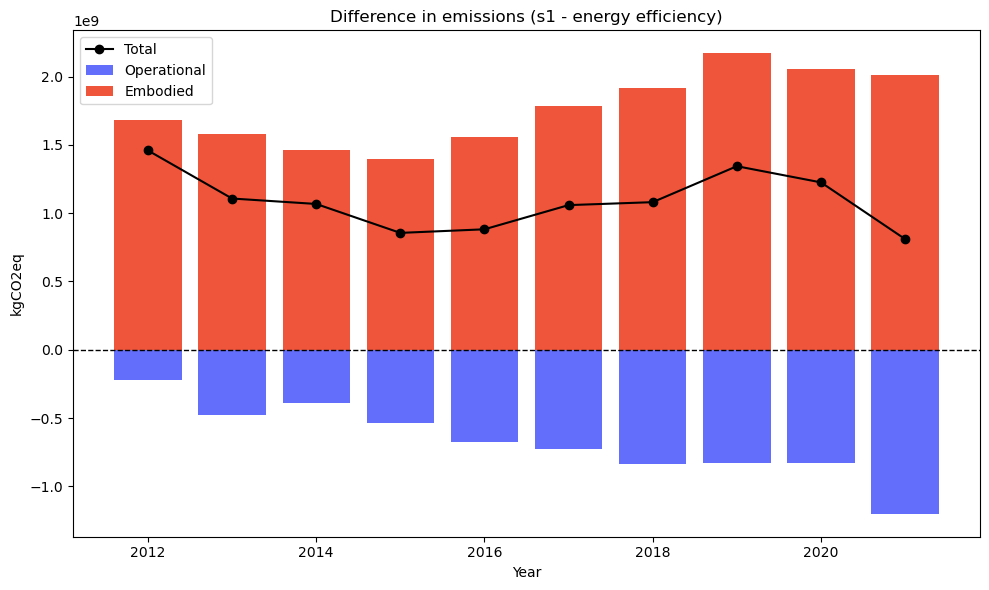

In [24]:
scenario_name = 's1'
scenario_full_name = 's1 - energy efficiency'

df = df_perYear.copy()
years = df['year']
operational = df[f'diff_operational_{scenario_name}']
embodied = df[f'diff_embodied_{scenario_name}']
total = df[f'diff_total_{scenario_name}']

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Plot the bars and line
bar1 = ax.bar(years, operational, label='Operational', color='#636EFA')
bar2 = ax.bar(years, embodied, label='Embodied', color='#EF553B')
ax.plot(years, total, label='Total', color='black', marker='o')

# Add labels and legend
ax.axhline(0, color='black', linestyle='--', linewidth=1)
ax.set_title(f'Difference in emissions ({scenario_full_name})')
ax.set_xlabel('Year')
ax.set_ylabel('kgCO2eq')
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

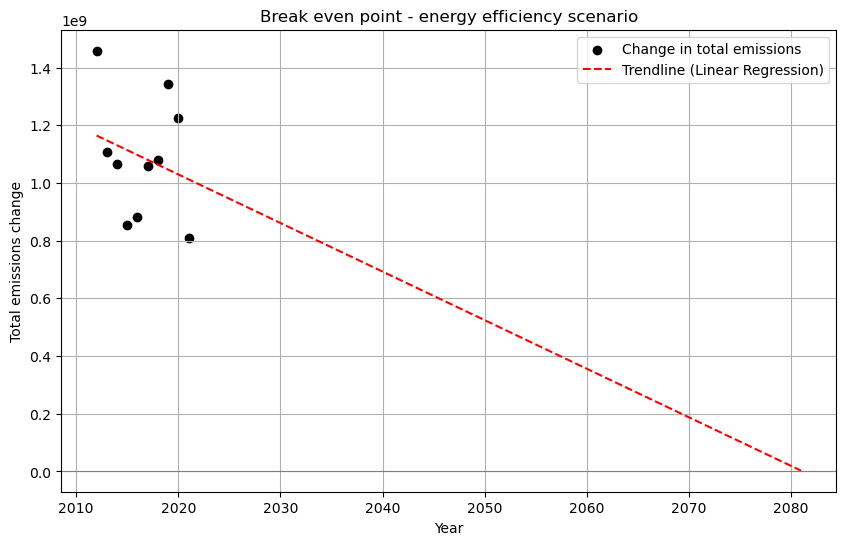

In [25]:
from sklearn.linear_model import LinearRegression
import numpy as np

df = df_perYear[['year', 'diff_total_s1']]

# Prepare data for linear regression
X = df['year'].values.reshape(-1, 1)
y = df['diff_total_s1'].values

# Fit a linear regression model
model = LinearRegression()
model.fit(X, y)

# Predict when the value will reach zero
year_zero = -model.intercept_ / model.coef_[0]

# Generate trendline
years = np.arange(df['year'].min(), int(year_zero) + 1)
predicted = model.predict(years.reshape(-1, 1))

# Plot the data and the trendline
plt.figure(figsize=(10, 6))
plt.scatter(df['year'], df['diff_total_s1'], color='black', label='Change in total emissions')
plt.plot(years, predicted, color='red', linestyle='--', label='Trendline (Linear Regression)')
plt.axhline(0, color='gray', linestyle='-', linewidth=0.8)
# plt.axvline(year_zero, color='green', linestyle='--', label=f'Zero Crossing: {year_zero:.1f}')
plt.xlabel('Year')
plt.ylabel('Total emissions change')
plt.title('Break even point - energy efficiency scenario')
plt.legend()
plt.grid(True)
plt.show()

In [26]:
scenario_name = 's1'
scenario_full_name = 's1 - energy efficiency'

df = gdf_perBuurt.copy() 
df_negative = df[(df[f'diff_total_{scenario_name}'] < 0)].bu_code.unique()
df_unchanged = df[(df[f'diff_total_{scenario_name}'] == 0)].bu_code.unique()
print(f'''In scenario {scenario_full_name}: 
{round(len(df_negative) / len(df) * 100)}% of neighborhoods benefitted, 
{round(len(df_unchanged) / len(df) * 100)}% of neighborhoods remained unchanged, and 
{round((len(df) - len(df_negative) - len(df_unchanged)) / len(df) * 100)}% of neighborhoods had increased emissions.''')

df = df_perBuurtPerYear.copy() 
df_benefited = df[df.bu_code.isin(df_negative)].drop(columns='bu_code')
df_benefited_mean = df_benefited.groupby('year').mean().reset_index()
df_benefited_sum = df_benefited.groupby('year').sum().reset_index()

df_not_benefited = df[~df.bu_code.isin(df_negative)].drop(columns='bu_code')
df_not_benefited_mean = df_not_benefited.groupby('year').mean().reset_index()
df_not_benefited_sum = df_not_benefited.groupby('year').sum().reset_index()

benefited_total_s0 = df_benefited.sum().total_kg_s0
benefited_total_s1 = df_benefited.sum().total_kg_s1
not_benefited_total_s0 = df_not_benefited.sum().total_kg_s0
not_benefited_total_s1 = df_not_benefited.sum().total_kg_s1
p_emissions_change_benefited = round(((benefited_total_s1 - benefited_total_s0) / benefited_total_s0) * 100)
print(f'''Neighborhoods that benefited from scenario {scenario_name} had a change in emissions of: {p_emissions_change_benefited}%''')

p_emissions_change_not_benefited = round(((not_benefited_total_s1 - not_benefited_total_s0) / not_benefited_total_s0) * 100)
print(f'''Neighborhoods that did not benefit from scenario {scenario_name} had a change in emissions of: {p_emissions_change_not_benefited}%''')

In scenario s1 - energy efficiency: 
22% of neighborhoods benefitted, 
1% of neighborhoods remained unchanged, and 
76% of neighborhoods had increased emissions.
Neighborhoods that benefited from scenario s1 had a change in emissions of: -1%
Neighborhoods that did not benefit from scenario s1 had a change in emissions of: 5%


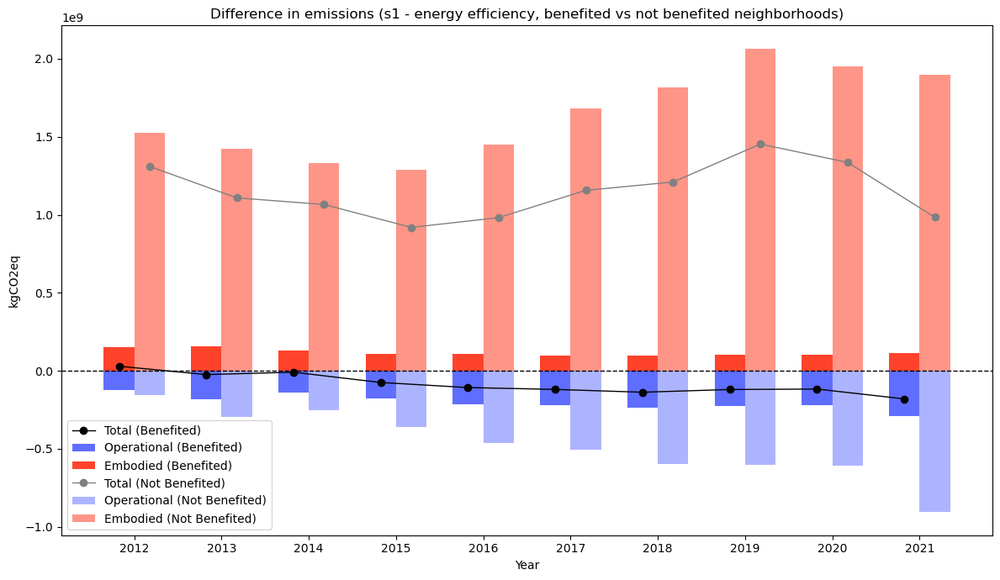

In [27]:
import matplotlib.pyplot as plt
import numpy as np

scenario_name = 's1'
scenario_full_name = 's1 - energy efficiency'

# Create the figure and axes
fig, ax = plt.subplots(figsize=(12, 7))

# Create data for the benefited neighborhoods
df_benefited = df_benefited_sum.copy()
years = df_benefited['year']
x = np.arange(len(years))  # The x locations for the groups
width = 0.35  # The width of the bars

operational_benefited = df_benefited[f'diff_operational_{scenario_name}']
embodied_benefited = df_benefited[f'diff_embodied_{scenario_name}']
total_benefited = df_benefited[f'diff_total_{scenario_name}']

# Create data for the not-benefited neighborhoods
df_not_benefited = df_not_benefited_sum.copy()
operational_not_benefited = df_not_benefited[f'diff_operational_{scenario_name}']
embodied_not_benefited = df_not_benefited[f'diff_embodied_{scenario_name}']
total_not_benefited = df_not_benefited[f'diff_total_{scenario_name}']

# Helper function to handle mixed signs
def calculate_bottom(operational, embodied):
    return np.where(
        (operational * embodied > 0), embodied, 0
    )
def calculate_bottom_reversed(operational, embodied): 
    return np.where(
        (embodied * operational > 0), operational, 0    
    )

# Plot the bars for benefited neighborhoods
bottom_benefited = calculate_bottom_reversed(operational_benefited, embodied_benefited)
bar1 = ax.bar(x - width / 2, operational_benefited, width, label='Operational (Benefited)', color='#606EFF') 
bar2 = ax.bar(x - width / 2, embodied_benefited, width, bottom=bottom_benefited, label='Embodied (Benefited)', color='#FF432B')
ax.plot(x - width / 2, total_benefited, label='Total (Benefited)', color='black', marker='o', linestyle='-', linewidth=1)

# Plot the bars for not-benefited neighborhoods
bottom_not_benefited = calculate_bottom(operational_not_benefited, embodied_not_benefited)
bar3 = ax.bar(x + width / 2, embodied_not_benefited, width, label='Embodied (Not Benefited)', color='#ff9587')
bar4 = ax.bar(x + width / 2, operational_not_benefited, width, bottom=bottom_not_benefited, label='Operational (Not Benefited)', color='#adb4ff')
ax.plot(x + width / 2, total_not_benefited, label='Total (Not Benefited)', color='grey', marker='o', linestyle='-', linewidth=1)

# Add labels, legend, and formatting
ax.axhline(0, color='black', linestyle='--', linewidth=1)
ax.set_title(f'Difference in emissions ({scenario_full_name}, benefited vs not benefited neighborhoods)')
ax.set_xlabel('Year')
ax.set_ylabel('kgCO2eq')
ax.set_xticks(x)
ax.set_xticklabels(years)
# Reorder legend
handles, labels = ax.get_legend_handles_labels()
order = [0, 2, 3, 1, 5, 4]  
ax.legend([handles[idx] for idx in order], [labels[idx] for idx in order])

# Show the plot
plt.tight_layout()
plt.show()


### Box plots comparing neighborhoods that benefited with those that didn't

In [28]:
query = f''' 
    WITH stats_perbuurt_peryear AS (
        SELECT bu_code, year, 
            inuse, n_homes, inuse / n_homes AS home_size, 
            tot_gas_m3, tot_elec_kwh, 
            tot_gas_m3 / inuse AS gas_per_sqm, 
            tot_elec_kwh / inuse AS elec_per_sqm, 
            population, 
            population / n_homes AS n_people_per_home, 
            population / ST_Area(bu_geom) * 1000000 AS population_density,
            woz, av_build_year, 
            construction, renovation, transformation, demolition, 
            construction / inuse * 100 AS p_construction, 
            renovation / inuse * 100 AS p_renovation, 
            transformation / inuse * 100 AS p_transformation, 
            demolition / inuse * 100 AS p_demolition 
        FROM buurt_stats
        WHERE n_homes > 0
    ), 
    stats_perbuurt AS (
        SELECT bu_code, 
            AVG(inuse) AS inuse, AVG(n_homes) AS n_homes, AVG(home_size) AS home_size, AVG(av_build_year) AS av_build_year,
            SUM(tot_gas_m3) AS tot_gas_m3, SUM(tot_elec_kwh) AS tot_elec_kwh, 
            AVG(gas_per_sqm) AS gas_per_sqm, AVG(elec_per_sqm) AS elec_per_sqm, 
            AVG(n_people_per_home) AS n_people_per_home, AVG(woz) AS woz, 
            AVG(population) AS population, AVG(population_density) AS population_density,
            SUM(construction) AS construction, SUM(renovation) AS renovation, 
            SUM(transformation) AS transformation, SUM(demolition) AS demolition, 
            AVG(p_construction) AS p_construction, AVG(p_renovation) AS p_renovation, 
            AVG(p_transformation) AS p_transformation, AVG(p_demolition) AS p_demolition 
        FROM stats_perbuurt_peryear
        GROUP BY bu_code
        ORDER BY AVG(home_size)
    ), 
    n_homes_2012 AS (
        SELECT year, bu_code, n_homes 
        FROM buurt_stats 
        WHERE year = 2012 
    ), 
    n_homes_2021 AS (
        SELECT year, bu_code, n_homes
        FROM buurt_stats
        WHERE year = 2021 
    ), 
    n_new_homes AS (
        SELECT a.bu_code, b.n_homes - a.n_homes AS n_new_homes 
        FROM n_homes_2012 a 
        JOIN n_homes_2021 b 
        ON a.bu_code = b.bu_code 
    )

    SELECT a.*, b.n_new_homes
    FROM stats_perbuurt a 
    JOIN n_new_homes b 
    ON a.bu_code = b.bu_code 
    ''' 

stats_perBuurt = pd.read_sql_query(query, engine)

In [34]:
import math
from plotly.subplots import make_subplots

scenario_name = 's1'
scenario_full_name = 's1 - energy efficiency'

df = gdf_perBuurt[['bu_code', f'diff_total_{scenario_name}']].copy() 
df = pd.merge(df, stats_perBuurt, on='bu_code', how='inner')

df['benefited'] = df[f'diff_total_{scenario_name}'].map(lambda x: 'yes' if x < 0 else 'no')

# Define characteristics
# buurt_characteristics = ['inuse', 'n_homes', 'home_size', 'n_new_homes', 'av_build_year',
#                          'population_density', 'population', 'n_people_per_home', 'woz',
#                          'gas_per_sqm', 'elec_per_sqm', 
#                          'tot_gas_m3', 'tot_elec_kwh', 
#                          'construction', 'renovation', 'transformation', 'demolition']
buurt_characteristics = ['home_size', 'n_new_homes', 'population_density', 'construction', 'renovation', 
                         'gas_per_sqm', 'elec_per_sqm']

# Calculate grid dimensions
n_cols = 7
n_rows = math.ceil(len(buurt_characteristics) / n_cols)

# Create a subplot figure with 4 plots per row
fig = make_subplots(rows=n_rows, cols=n_cols, 
                    subplot_titles=buurt_characteristics)

# Add each plot to the grid
for i, col_name in enumerate(buurt_characteristics):
    df_adjusted = df.copy()
    df_adjusted = df_adjusted[df_adjusted[col_name].notnull()]
    outliers_dict = {
        'home_size': ['<', 500],
        'gas_per_sqm': ['<', 40],
        'elec_per_sqm': ['<', 100],
        'n_people_per_home': ['<', 10], 
        'av_build_year': ['>', 1800]
    }
    if col_name in outliers_dict:
        if outliers_dict[col_name][0] == '<':
            df_adjusted = df_adjusted[df_adjusted[col_name] < outliers_dict[col_name][1]]
        elif outliers_dict[col_name][0] == '>':
            df_adjusted = df_adjusted[df_adjusted[col_name] > outliers_dict[col_name][1]]
    
    # Create a box plot
    box_fig = px.box(df_adjusted, x='benefited', y=col_name, color='benefited', category_orders={'benefited': ['yes', 'no']})
    for trace in box_fig.data:
        row = (i // n_cols) + 1
        col = (i % n_cols) + 1
        fig.add_trace(trace, row=row, col=col)
        fig.update_yaxes(type='log', row=row, col=col)
        if col_name == 'av_build_year':
            fig.update_yaxes(type='linear', row=row, col=col)

# Update layout
fig.update_layout(height=400 * n_rows, width=1000, showlegend=False)
fig.update_layout(
    height=400 * n_rows,
    width=1000,
    showlegend=False,
    annotations=[
        dict(
            font=dict(size=12)  # Adjust the font size here
        ) if 'text' in ann else ann
        for ann in fig['layout']['annotations']
    ]
)
fig.show()

### Scenario 1 scatter plots 

In [20]:
# Add a new column to determine the color based on the condition
gdf = gdf_perBuurt.copy()
gdf = gdf[gdf.diff_operational_s1 <= 0]
gdf['color'] = gdf['diff_total_s1_pct'].apply(lambda x: 'increased emissions' if x > 0 else 'decreased emissions')

# Create the scatter plot with the custom color
fig = px.scatter(
    gdf, 
    x='diff_operational_s1', 
    y='diff_embodied_s1', 
    # z='diff_total_s1',
    hover_name='bu_code', 
    color='color',  # Use the color column
    color_discrete_map={'increased emissions': 'red', 'decreased emissions': 'blue'},  # Map color values to specific colors
    title="Percentage change in operational vs embodied emissions for neighborhoods"
)

fig.update_layout(width=800, height=700)
fig.show()


# Scenario 2 - material efficiency

In [35]:
query = f''' 
WITH emissions_year AS (
    SELECT year,  
        SUM(operational_kg_s0) AS operational_kg_s0, 
        SUM(operational_kg_s1) AS operational_kg_s1,
        SUM(operational_kg_s2) AS operational_kg_s2,
        SUM(operational_kg_s1) - SUM(operational_kg_s0) AS diff_operational_s1,
        SUM(operational_kg_s2) - SUM(operational_kg_s0) AS diff_operational_s2,
        SUM(embodied_kg_s0) AS embodied_kg_s0, 
        SUM(embodied_kg_s1) AS embodied_kg_s1,
        SUM(embodied_kg_s2) AS embodied_kg_s2,
        SUM(embodied_kg_s1) - SUM(embodied_kg_s0) AS diff_embodied_s1,
        SUM(embodied_kg_s2) - SUM(embodied_kg_s0) AS diff_embodied_s2,
		SUM(operational_kg_s0) + SUM(embodied_kg_s0) AS total_kg_s0,
		SUM(operational_kg_s1) + SUM(embodied_kg_s1) AS total_kg_s1,
		SUM(operational_kg_s2) + SUM(embodied_kg_s2) AS total_kg_s2,
		(SUM(operational_kg_s1) + SUM(embodied_kg_s1) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s1,
		(SUM(operational_kg_s2) + SUM(embodied_kg_s2) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s2
    FROM emissions_all_buurt_s2
    GROUP BY year
)
SELECT * FROM emissions_year ORDER BY year
'''

df_perYear = pd.read_sql_query(query, engine)

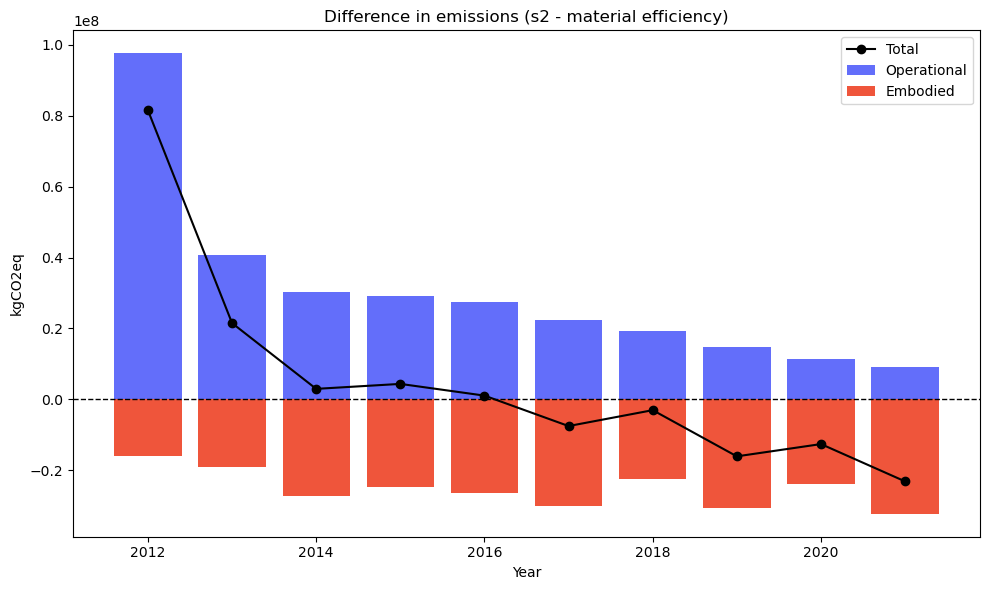

In [36]:
scenario_name = 's2'
scenario_full_name = 's2 - material efficiency'

df = df_perYear.copy()
years = df['year']
operational = df[f'diff_operational_{scenario_name}']
embodied = df[f'diff_embodied_{scenario_name}']
total = df[f'diff_total_{scenario_name}']

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Plot the bars and line
bar1 = ax.bar(years, operational, label='Operational', color='#636EFA')
bar2 = ax.bar(years, embodied, label='Embodied', color='#EF553B')
ax.plot(years, total, label='Total', color='black', marker='o')

# Add labels and legend
ax.axhline(0, color='black', linestyle='--', linewidth=1)
ax.set_title(f'Difference in emissions ({scenario_full_name})')
ax.set_xlabel('Year')
ax.set_ylabel('kgCO2eq')
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

In [37]:
query = f''' 
WITH scenario_stats_raw AS (
	SELECT 
		municipality, bu_code, 

		-- embodied emissions stats 
		SUM(embodied_kg_s0) AS embodied_kg_s0, 
		SUM(embodied_kg_s1) AS embodied_kg_s1, 
		SUM(embodied_kg_s2) AS embodied_kg_s2, 
		SUM(embodied_kg_s1) - SUM(embodied_kg_s0) AS diff_embodied_s1, 
		SUM(embodied_kg_s2) - SUM(embodied_kg_s0) AS diff_embodied_s2, 
		CASE 
			WHEN SUM(embodied_kg_s0) = 0 THEN 0
			ELSE ((SUM(embodied_kg_s1) - SUM(embodied_kg_s0)) / SUM(embodied_kg_s0)) * 100
		END AS diff_embodied_s1_pct, 
		CASE 
			WHEN SUM(embodied_kg_s0) = 0 THEN 0
			ELSE ((SUM(embodied_kg_s2) - SUM(embodied_kg_s0)) / SUM(embodied_kg_s0)) * 100
		END AS diff_embodied_s2_pct, 
        AVG(embodied_kg_s0 / n_homes) AS embodied_per_home,

		-- operational emissions stats 
		SUM(operational_kg_s0) AS operational_kg_s0, 
		SUM(operational_kg_s1) AS operational_kg_s1, 
		SUM(operational_kg_s2) AS operational_kg_s2, 
		SUM(operational_kg_s1) - SUM(operational_kg_s0) AS diff_operational_s1, 
		SUM(operational_kg_s2) - SUM(operational_kg_s0) AS diff_operational_s2, 
		CASE 
			WHEN SUM(operational_kg_s0) = 0 THEN 0
			ELSE ((SUM(operational_kg_s1) - SUM(operational_kg_s0)) / SUM(operational_kg_s0)) * 100
		END AS diff_operational_s1_pct, 
		CASE 
			WHEN SUM(operational_kg_s0) = 0 THEN 0
			ELSE ((SUM(operational_kg_s2) - SUM(operational_kg_s0)) / SUM(operational_kg_s0)) * 100
		END AS diff_operational_s2_pct, 
        AVG(operational_kg_s0 / n_homes) AS operational_per_home,

		-- total emissions stats 
		SUM(embodied_kg_s0) + SUM(operational_kg_s0) AS total_kg_s0, 
		SUM(embodied_kg_s1) + SUM(operational_kg_s1) AS total_kg_s1, 
		SUM(embodied_kg_s2) + SUM(operational_kg_s2) AS total_kg_s2, 
		(SUM(embodied_kg_s1) + SUM(operational_kg_s1)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0)) AS diff_total_s1, 
		(SUM(embodied_kg_s2) + SUM(operational_kg_s2)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0)) AS diff_total_s2, 
		CASE 
			WHEN SUM(embodied_kg_s0) + SUM(operational_kg_s0) = 0 THEN 0
			ELSE (((SUM(embodied_kg_s1) + SUM(operational_kg_s1)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) / (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) * 100
		END AS diff_total_s1_pct, 
		CASE 
			WHEN SUM(embodied_kg_s0) + SUM(operational_kg_s0) = 0 THEN 0
			ELSE (((SUM(embodied_kg_s2) + SUM(operational_kg_s2)) - (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) / (SUM(embodied_kg_s0) + SUM(operational_kg_s0))) * 100
		END AS diff_total_s2_pct, 

		-- buurt stats 
		AVG(population) AS av_population, 
		AVG(population / ST_Area(bu_geom) * 1000000) AS av_population_density, 
		AVG(n_homes) AS av_n_homes, 
		AVG(woz) AS av_woz, 
		AVG(inuse / n_homes) AS av_home_size, 

		-- construction activity stats 
		AVG(construction / inuse * 100) AS av_p_construction, 
		AVG(renovation / inuse * 100) AS av_p_renovation, 
		AVG(transformation / inuse * 100) AS av_p_transformation, 
		AVG(demolition / inuse * 100) AS av_p_demolition

	FROM emissions_all_buurt_s2 
	WHERE n_homes > 0 AND population > 0 AND inuse > 0
	GROUP BY municipality, bu_code 
), 
scenario_stats AS (
	SELECT * FROM scenario_stats_raw 
    WHERE operational_kg_s0 > 0
), 
bu_geoms AS (
	SELECT "BU_CODE" AS bu_code, geometry AS bu_geom
	FROM cbs_map_2022
	WHERE "WATER" = 'NEE'
), 
scenario_stats_with_bu_geoms AS (
	SELECT 
		a.municipality, b.bu_code, b.bu_geom, 
		a.embodied_kg_s0, a.embodied_kg_s1, a.embodied_kg_s2, 
		a.diff_embodied_s1, a.diff_embodied_s2, 
		a.diff_embodied_s1_pct, a.diff_embodied_s2_pct, 
        a.embodied_per_home, 
		a.operational_kg_s0, a.operational_kg_s1, a.operational_kg_s2, 
		a.diff_operational_s1, a.diff_operational_s2,  
		a.diff_operational_s1_pct, a.diff_operational_s2_pct, 
        a.operational_per_home,
		a.total_kg_s0, a.total_kg_s1, a.total_kg_s2, 
		a.diff_total_s1, a.diff_total_s2,
		a.diff_total_s1_pct, a.diff_total_s2_pct, 
		a.av_population, a.av_n_homes, a.av_population_density, a.av_woz, a.av_home_size, 
		a.av_p_construction, a.av_p_renovation, a.av_p_transformation, a.av_p_demolition 
	FROM scenario_stats a 
	FULL JOIN bu_geoms b 
	ON a.bu_code = b.bu_code
), 

-- add n_new_homes column
scenario_stats_2012_2021 AS (
    SELECT 
        year, 
        municipality, 
        bu_code, 
        n_homes
    FROM 
        emissions_all_buurt_s3 
    WHERE 
        n_homes > 0 
        AND population > 0 
        AND (year = 2012 OR year = 2021)
),
scenario_stats_2012_2021_pivoted AS (
    SELECT
        bu_code,
        MAX(CASE WHEN year = 2012 THEN n_homes ELSE NULL END) AS n_homes_2012,
        MAX(CASE WHEN year = 2021 THEN n_homes ELSE NULL END) AS n_homes_2021
    FROM 
        scenario_stats_2012_2021
    GROUP BY 
        bu_code
), 
n_new_homes AS (
	SELECT
	    bu_code,
	    COALESCE(n_homes_2021, 0) - COALESCE(n_homes_2012, 0) AS n_new_homes
	FROM
	    scenario_stats_2012_2021_pivoted
)

SELECT a.*, b.n_new_homes
FROM scenario_stats_with_bu_geoms a 
LEFT JOIN n_new_homes b 
ON a.bu_code = b.bu_code 
'''

gdf_perBuurt = gpd.read_postgis(query, engine, geom_col='bu_geom')
gdf_no_data = gdf_perBuurt[(gdf_perBuurt.diff_total_s1_pct.isna()) | (gdf_perBuurt.diff_operational_s1 > 0)]


In [38]:
scenario_name = 's2'
scenario_full_name = 's2 - material efficiency'

df = gdf_perBuurt.copy() 
df_negative = df[(df[f'diff_total_{scenario_name}'] < 0) & (df.diff_embodied_s2 != 0)].bu_code.unique()
df_unchanged = df[(df[f'diff_total_{scenario_name}'] == 0)].bu_code.unique()
print(f'''In scenario 2: 
{round(len(df_negative) / len(df) * 100)}% of neighborhoods benefitted, 
{round(len(df_unchanged) / len(df) * 100)}% of neighborhoods remained unchanged, and 
{round((len(df) - len(df_negative) - len(df_unchanged)) / len(df) * 100)}% of neighborhoods had increased emissions.''')

df_benefited = df[df.bu_code.isin(df_negative)].drop(columns=['bu_code', 'bu_geom'])
df_not_benefited = df[~df.bu_code.isin(df_negative)].drop(columns='bu_code')
benefited_total_s0 = df_benefited.total_kg_s0.sum()
benefited_total_s2 = df_benefited.total_kg_s2.sum()
not_benefited_total_s0 = df_not_benefited.total_kg_s0.sum()
not_benefited_total_s2 = df_not_benefited.total_kg_s2.sum()
p_emissions_change_benefited = round(((benefited_total_s2 - benefited_total_s0) / benefited_total_s0) * 100,2)
print(f'''Neighborhoods that benefited from scenario {scenario_name} had a change in emissions of: {p_emissions_change_benefited}%''')
p_emissions_change_not_benefited = round(((not_benefited_total_s2 - not_benefited_total_s0) / not_benefited_total_s0) * 100,2)
print(f'''Neighborhoods that did not benefit from scenario {scenario_name} had a change in emissions of: {p_emissions_change_not_benefited}%''')


In scenario 2: 
9% of neighborhoods benefitted, 
4% of neighborhoods remained unchanged, and 
88% of neighborhoods had increased emissions.
Neighborhoods that benefited from scenario s2 had a change in emissions of: -0.22%
Neighborhoods that did not benefit from scenario s2 had a change in emissions of: 0.03%


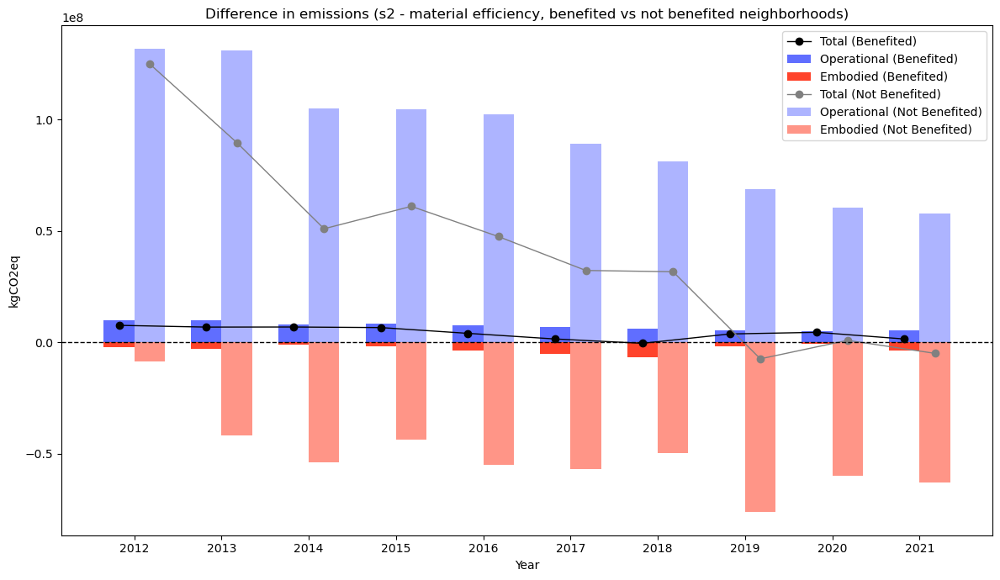

In [39]:
import matplotlib.pyplot as plt
import numpy as np

scenario_name = 's2'
scenario_full_name = 's2 - material efficiency'

# Create the figure and axes
fig, ax = plt.subplots(figsize=(12, 7))

# Create data for the benefited neighborhoods
df_benefited = df_benefited_sum.copy()
years = df_benefited['year']
x = np.arange(len(years))  # The x locations for the groups
width = 0.35  # The width of the bars

operational_benefited = df_benefited[f'diff_operational_{scenario_name}']
embodied_benefited = df_benefited[f'diff_embodied_{scenario_name}']
total_benefited = df_benefited[f'diff_total_{scenario_name}']

# Create data for the not-benefited neighborhoods
df_not_benefited = df_not_benefited_sum.copy()
operational_not_benefited = df_not_benefited[f'diff_operational_{scenario_name}']
embodied_not_benefited = df_not_benefited[f'diff_embodied_{scenario_name}']
total_not_benefited = df_not_benefited[f'diff_total_{scenario_name}']

# Helper function to handle mixed signs
def calculate_bottom(operational, embodied):
    return np.where(
        (operational * embodied > 0), embodied, 0
    )
def calculate_bottom_reversed(operational, embodied): 
    return np.where(
        (embodied * operational > 0), operational, 0    
    )

# Plot the bars for benefited neighborhoods
bottom_benefited = calculate_bottom_reversed(operational_benefited, embodied_benefited)
bar1 = ax.bar(x - width / 2, operational_benefited, width, label='Operational (Benefited)', color='#606EFF') 
bar2 = ax.bar(x - width / 2, embodied_benefited, width, bottom=bottom_benefited, label='Embodied (Benefited)', color='#FF432B')
ax.plot(x - width / 2, total_benefited, label='Total (Benefited)', color='black', marker='o', linestyle='-', linewidth=1)

# Plot the bars for not-benefited neighborhoods
bottom_not_benefited = calculate_bottom(operational_not_benefited, embodied_not_benefited)
bar3 = ax.bar(x + width / 2, embodied_not_benefited, width, label='Embodied (Not Benefited)', color='#ff9587')
bar4 = ax.bar(x + width / 2, operational_not_benefited, width, bottom=bottom_not_benefited, label='Operational (Not Benefited)', color='#adb4ff')
ax.plot(x + width / 2, total_not_benefited, label='Total (Not Benefited)', color='grey', marker='o', linestyle='-', linewidth=1)

# Add labels, legend, and formatting
ax.axhline(0, color='black', linestyle='--', linewidth=1)
ax.set_title(f'Difference in emissions ({scenario_full_name}, benefited vs not benefited neighborhoods)')
ax.set_xlabel('Year')
ax.set_ylabel('kgCO2eq')
ax.set_xticks(x)
ax.set_xticklabels(years)
# Reorder legend
handles, labels = ax.get_legend_handles_labels()
order = [0, 2, 3, 1, 5, 4]  
ax.legend([handles[idx] for idx in order], [labels[idx] for idx in order])

# Show the plot
plt.tight_layout()
plt.show()


In [40]:
import math
from plotly.subplots import make_subplots

scenario_name = 's2'
scenario_full_name = 's2 - material efficiency'

df = gdf_perBuurt[['bu_code', f'diff_total_{scenario_name}', 'diff_embodied_s2', 'bu_geom']].copy() 
df = pd.merge(df, stats_perBuurt, on='bu_code', how='inner')
def benefited(row): 
    if (row[f'diff_total_{scenario_name}'] < 0) & (row.diff_embodied_s2 != 0): 
        return 'yes'
    else: 
        return 'no'
df['benefited'] = df.apply(lambda row: benefited(row), axis=1)

# Define characteristics
# buurt_characteristics = ['inuse', 'n_homes', 'home_size', 'n_new_homes', 'av_build_year',
#                          'population_density', 'n_people_per_home', 'woz',
#                          'gas_per_sqm', 'elec_per_sqm', 
#                          'tot_gas_m3', 'tot_elec_kwh', 
#                          'construction', 'renovation', 'transformation', 'demolition']
buurt_characteristics = ['inuse', 'n_homes', 'home_size', 'n_new_homes', 'av_build_year', 
                         'population_density', 'construction', 'renovation', 'transformation', 'demolition',]

# Calculate grid dimensions
n_cols = 6
n_rows = math.ceil(len(buurt_characteristics) / n_cols)

# Create a subplot figure with 4 plots per row
fig = make_subplots(rows=n_rows, cols=n_cols, 
                    subplot_titles=buurt_characteristics)

# Add each plot to the grid
for i, col_name in enumerate(buurt_characteristics):
    df_adjusted = df.copy()
    df_adjusted = df_adjusted[df_adjusted[col_name].notnull()]
    outliers_dict = {
        'home_size': ['<', 500],
        'gas_per_sqm': ['<', 40],
        'elec_per_sqm': ['<', 100],
        'n_people_per_home': ['<', 10], 
        'av_build_year': ['>', 1800]
    }
    if col_name in outliers_dict:
        if outliers_dict[col_name][0] == '<':
            df_adjusted = df_adjusted[df_adjusted[col_name] < outliers_dict[col_name][1]]
        elif outliers_dict[col_name][0] == '>':
            df_adjusted = df_adjusted[df_adjusted[col_name] > outliers_dict[col_name][1]]
    
    # Create a box plot
    box_fig = px.box(df_adjusted, x='benefited', y=col_name, color='benefited', category_orders={'benefited': ['yes', 'no']})
    for trace in box_fig.data:
        row = (i // n_cols) + 1
        col = (i % n_cols) + 1
        fig.add_trace(trace, row=row, col=col)
        fig.update_yaxes(type='log', row=row, col=col)
        if col_name == 'av_build_year':
            fig.update_yaxes(type='linear', row=row, col=col)

# Update layout
fig.update_layout(height=400 * n_rows, width=1000, showlegend=False)
fig.show()

In [28]:
scenario_name = 's2'
scenario_full_name = 's2 - material efficiency'

df = gdf_perBuurt.copy()
df['benefited'] = df[f'diff_total_{scenario_name}'].map(lambda x: 'yes' if x < 0 else 'no')

# Create the scatter plot with the custom color
fig = px.scatter(
    df, 
    x='diff_operational_s2', 
    y='diff_embodied_s2', 
    # z='diff_total_s1',
    hover_name='bu_code', 
    color='benefited',  # Use the color column
    color_discrete_map={'no': 'red', 'yes': 'blue'},  # Map color values to specific colors
    title="Change in operational vs embodied emissions (s2 - material efficiency)"
)

fig.update_layout(width=800, height=700)
fig.show()

### % of housing (in sqm) that were renovated instead of demolished-and-rebuilt

In [29]:
# what % of demolished housing was renovated instead in s2? 
query = ''' 
SELECT status, SUM(sqm) AS sqm_s2 
FROM housing_nl_s2 
GROUP BY status 
'''
df = pd.read_sql_query(query, engine)
demolished_s2 = df[df.status == 'Pand gesloopt'].sqm_s2.iloc[0]
renovated_s2 = df[df.status == 'renovation - s1'].sqm_s2.iloc[0]
demolished_s0 = demolished_s2 + renovated_s2 
p_renovated_s2 = round(renovated_s2 / demolished_s0 * 100, 2)
print(f'{p_renovated_s2}% of demolished housing was renovated instead in s2')

5.34% of demolished housing was renovated instead in s2


In [30]:
df = gdf_perBuurt[['bu_code', f'diff_total_s2', 'diff_embodied_s2']].copy() 
def benefited(row): 
    if (row[f'diff_total_s2'] < 0) & (row.diff_embodied_s2 != 0): 
        return 'yes'
    else: 
        return 'no'
df['benefited'] = df.apply(lambda row: benefited(row), axis=1)
bu_codes_benefited = df[df.benefited == 'yes'].bu_code.unique()
bu_codes_not_benefited = df[df.benefited == 'no'].bu_code.unique()

query = ''' 
SELECT bu_code, status, SUM(sqm) AS sqm_s2
FROM housing_nl_s2 
WHERE status IN ('Pand gesloopt', 'renovation - s1')
GROUP BY bu_code, status 
'''
df_activity = pd.read_sql_query(query, engine)
df_activity_benefited = df_activity[df_activity.bu_code.isin(bu_codes_benefited)]
df = df_activity_benefited.copy() 
demolished_s2 = df[df.status == 'Pand gesloopt'].sum().sqm_s2
renovated_s2 = df[df.status == 'renovation - s1'].sum().sqm_s2
demolished_s0 = demolished_s2 + renovated_s2 
p_renovated_s2 = round(renovated_s2 / demolished_s0 * 100, 2)
print(f'in benefited neighborhoods, {p_renovated_s2}% of demolished housing was renovated instead in s2')

df_activity_not_benefited = df_activity[df_activity.bu_code.isin(bu_codes_not_benefited)]
df = df_activity_not_benefited.copy()
demolished_s2 = df[df.status == 'Pand gesloopt'].sum().sqm_s2
renovated_s2 = df[df.status == 'renovation - s1'].sum().sqm_s2
demolished_s0 = demolished_s2 + renovated_s2 
p_renovated_s2 = round(renovated_s2 / demolished_s0 * 100, 2)
print(f'in not benefited neighborhoods, {p_renovated_s2}% of demolished housing was renovated instead in s2')

in benefited neighborhoods, 11.02% of demolished housing was renovated instead in s2
in not benefited neighborhoods, 3.59% of demolished housing was renovated instead in s2


In [44]:
query = ''' 
SELECT year, status, SUM(sqm) AS sqm
FROM housing_nl_s2 
WHERE status IN ('Pand gesloopt', 'renovation - s1')
	AND year BETWEEN 2012 AND 2021
GROUP BY year, status 
'''
df = pd.read_sql_query(query, engine)
df = df.pivot_table(index='year', columns='status', values='sqm', aggfunc='sum').reset_index()
df.rename(columns={'Pand gesloopt': 'demolished', 'renovation - s1': 'renovated'}, inplace=True)
df['demolished_s0'] = df.demolished + df.renovated
df['p_renovated'] = df.renovated / df.demolished_s0 * 100

fig = px.line(df, x='year', y='p_renovated', title='Percentage of demolished housing renovated instead in s2')
fig.update_layout(width=700)
fig.show()

# Scenario 3 - space efficiency

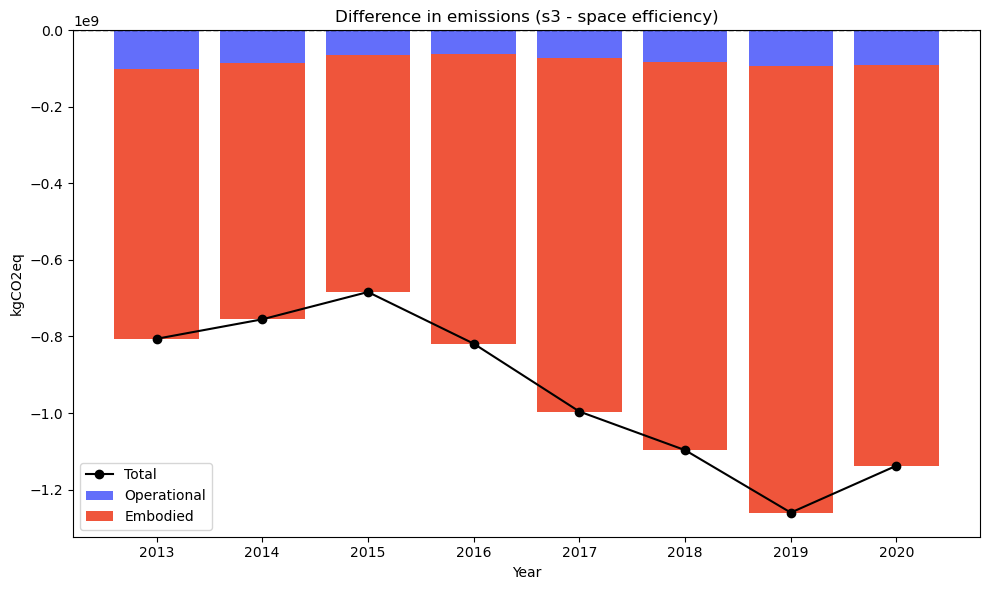

In [32]:
scenario_name = 's3'
scenario_full_name = 's3 - space efficiency'

df = df_perYear.copy()
df = df[(df.year > 2012) & (df.year < 2021)]
years = df['year']
operational = df[f'diff_operational_{scenario_name}']
embodied = df[f'diff_embodied_{scenario_name}']
total = df[f'diff_total_{scenario_name}']

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Plot the bars and line
bar1 = ax.bar(years, operational, label='Operational', color='#636EFA')
bar2 = ax.bar(years, embodied, label='Embodied', color='#EF553B', bottom=operational)
ax.plot(years, total, label='Total', color='black', marker='o')

# Add labels and legend
ax.axhline(0, color='black', linestyle='--', linewidth=1)
ax.set_title(f'Difference in emissions ({scenario_full_name})')
ax.set_xlabel('Year')
ax.set_ylabel('kgCO2eq')
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

In [33]:
import math
from plotly.subplots import make_subplots

scenario_name = 's3'
scenario_full_name = 's3 - space efficiency'

df = gdf_perBuurt[['bu_code', f'diff_total_{scenario_name}']].copy() 
df = pd.merge(df, stats_perBuurt, on='bu_code', how='inner')

df['benefited'] = df[f'diff_total_{scenario_name}'].map(lambda x: 'yes' if x > 0 else 'no')

# Define characteristics
buurt_characteristics = ['inuse', 'n_homes', 'home_size', 
                         'gas_per_sqm', 'elec_per_sqm', 'n_people_per_home', 'woz', 
                         'tot_gas_m3', 'tot_elec_kwh', 
                         'construction', 'renovation', 'transformation', 'demolition']

# Calculate grid dimensions
n_cols = 7
n_rows = math.ceil(len(buurt_characteristics) / n_cols)

# Create a subplot figure with 4 plots per row
fig = make_subplots(rows=n_rows, cols=n_cols, 
                    subplot_titles=buurt_characteristics)

# Add each plot to the grid
for i, col_name in enumerate(buurt_characteristics):
    df_adjusted = df.copy()
    df_adjusted = df_adjusted[df_adjusted[col_name].notnull()]
    outliers_dict = {
        'home_size': 500,
        'gas_per_sqm': 40,
        'elec_per_sqm': 100,
        'n_people_per_home': 10
    }
    if col_name in outliers_dict:
        df_adjusted = df_adjusted[df_adjusted[col_name] < outliers_dict[col_name]]
    
    # Create a box plot
    box_fig = px.box(df_adjusted, x='benefited', y=col_name, color='benefited')
    for trace in box_fig.data:
        row = (i // n_cols) + 1
        col = (i % n_cols) + 1
        fig.add_trace(trace, row=row, col=col)
        fig.update_yaxes(type='log', row=row, col=col)

# Update layout
fig.update_layout(height=400 * n_rows, width=1200, showlegend=False)
fig.show()

In [26]:
gdf = gdf_perBuurt.copy()
gdf = gdf[gdf.diff_total_s3 <= 0]
gdf['color'] = gdf['diff_total_s3_pct'].apply(lambda x: 'increased emissions' if x > 0 else 'decreased emissions')

# Create the scatter plot with the custom color
fig = px.scatter(
    gdf, 
    x='diff_operational_s3', 
    y='diff_embodied_s3', 
    # z='diff_total_s1',
    hover_name='bu_code', 
    color='color',  # Use the color column
    color_discrete_map={'increased emissions': 'red', 'decreased emissions': 'blue'},  # Map color values to specific colors
    title="Percentage change in operational vs embodied emissions for neighborhoods"
)

fig.update_layout(width=800, height=700)
fig.show()

# comparing the three sceanrios

In [105]:
query = ''' 
WITH emissions_year AS (
    SELECT
        SUM(operational_kg_s0) AS operational_kg_s0, 
        SUM(operational_kg_s1) AS operational_kg_s1,
        SUM(operational_kg_s2) AS operational_kg_s2,
        SUM(operational_kg_s3) AS operational_kg_s3, 
        SUM(operational_kg_s1) - SUM(operational_kg_s0) AS diff_operational_s1,
        SUM(operational_kg_s2) - SUM(operational_kg_s0) AS diff_operational_s2,
        SUM(operational_kg_s3) - SUM(operational_kg_s0) AS diff_operational_s3,
        SUM(embodied_kg_s0) AS embodied_kg_s0, 
        SUM(embodied_kg_s1) AS embodied_kg_s1,
        SUM(embodied_kg_s2) AS embodied_kg_s2,
        SUM(embodied_kg_s3) AS embodied_kg_s3, 
        SUM(embodied_kg_s1) - SUM(embodied_kg_s0) AS diff_embodied_s1,
        SUM(embodied_kg_s2) - SUM(embodied_kg_s0) AS diff_embodied_s2,
        SUM(embodied_kg_s3) - SUM(embodied_kg_s0) AS diff_embodied_s3,
		SUM(operational_kg_s0) + SUM(embodied_kg_s0) AS total_kg_s0,
		SUM(operational_kg_s1) + SUM(embodied_kg_s1) AS total_kg_s1,
		SUM(operational_kg_s2) + SUM(embodied_kg_s2) AS total_kg_s2,
		SUM(operational_kg_s3) + SUM(embodied_kg_s3) AS total_kg_s3,
		(SUM(operational_kg_s1) + SUM(embodied_kg_s1) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s1,
		(SUM(operational_kg_s2) + SUM(embodied_kg_s2) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s2,
		(SUM(operational_kg_s3) + SUM(embodied_kg_s3) - (SUM(operational_kg_s0) + SUM(embodied_kg_s0))) AS diff_total_s3
    FROM emissions_all_buurt_s3
)
SELECT * FROM emissions_year
'''

df_raw = pd.read_sql_query(query, engine)

In [114]:
import pandas as pd

# Example DataFrame (replace with your actual DataFrame)
data = {
    'diff_operational_s1': df['diff_operational_s1'] / 1e9,  # Convert kg to Mtons
    'diff_operational_s2': df['diff_operational_s2'] / 1e9,
    'diff_operational_s3': df['diff_operational_s3'] / 1e9,
    'diff_operational_s1_pct': df['diff_operational_s1'] / df['operational_kg_s0'] * 100,  # Percentage
    'diff_operational_s2_pct': df['diff_operational_s2'] / df['operational_kg_s0'] * 100,
    'diff_operational_s3_pct': df['diff_operational_s3'] / df['operational_kg_s0'] * 100,
    # Embodied
    'diff_embodied_s1': df['diff_embodied_s1'] / 1e9,
    'diff_embodied_s2': df['diff_embodied_s2'] / 1e9,
    'diff_embodied_s3': df['diff_embodied_s3'] / 1e9,
    'diff_embodied_s1_pct': df['diff_embodied_s1'] / df['embodied_kg_s0'] * 100,
    'diff_embodied_s2_pct': df['diff_embodied_s2'] / df['embodied_kg_s0'] * 100,
    'diff_embodied_s3_pct': df['diff_embodied_s3'] / df['embodied_kg_s0'] * 100,
    # Total
    'diff_total_s1': df['diff_total_s1'] / 1e9,
    'diff_total_s2': df['diff_total_s2'] / 1e9,
    'diff_total_s3': df['diff_total_s3'] / 1e9,
    'diff_total_s1_pct': df['diff_total_s1'] / df['total_kg_s0'] * 100,
    'diff_total_s2_pct': df['diff_total_s2'] / df['total_kg_s0'] * 100,
    'diff_total_s3_pct': df['diff_total_s3'] / df['total_kg_s0'] * 100,
}

# Create a DataFrame for all scenarios
scenarios = ['s1', 's2', 's3']
rows = []
for s in scenarios:
    rows.append({
        'scenario': s,
        'change embodied (Mtons)': data[f'diff_embodied_{s}'].sum(),  # Sum across the dataset
        'change embodied (%)': data[f'diff_embodied_{s}_pct'].mean(),  # Average percentage
        'change operational (Mtons)': data[f'diff_operational_{s}'].sum(),
        'change operational (%)': data[f'diff_operational_{s}_pct'].mean(),
        'change total (Mtons)': data[f'diff_total_{s}'].sum(),
        'change total (%)': data[f'diff_total_{s}_pct'].mean()
    })

# Convert rows to a DataFrame
result_df = pd.DataFrame(rows)

# Display the resulting DataFrame
result_df

,scenario,change embodied (Mtons),change embodied (%),change operational (Mtons),change operational (%),change total (Mtons),change total (%)
0,s1,17.603347,66.318844,-6.715082,-2.305640,10.888265,3.426252
1,s2,-0.538200,-2.027613,1.061591,0.364500,0.523391,0.164698
2,s3,-7.734721,-29.139785,-0.652729,-0.224116,-8.387450,-2.639311


In [107]:
# Melt the DataFrame into a long format
df_melted = df_raw.melt(var_name="type_scenario", value_name="value")

# Split "type_scenario" into multiple columns
df_melted[["type", "scenario"]] = df_melted["type_scenario"].str.extract(r"(.+?)_(s\d)")

# Determine "emissions type" and "diff type"
df_melted["emissions type"] = df_melted["type"].apply(
    lambda x: "operational" if "operational" in x else "embodied" if "embodied" in x else "total"
)
df_melted["diff type"] = df_melted["type"].apply(lambda x: "diff" if "diff" in x else "not_diff")

# Drop the intermediate columns and keep the desired ones
df = df_melted[["scenario", "emissions type", "diff type", "value"]]
df['value_ktons'] = df['value'] / 1000000000
df[df['diff type'] == 'diff'].sort_values(by='emissions type')


/var/folders/r0/dcf480211ql6v50vx1qh0m080000gn/T/ipykernel_27043/1908944474.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,scenario,emissions type,diff type,value,value_ktons
11,s1,embodied,diff,1.760335e+10,17.603347
12,s2,embodied,diff,-5.381997e+08,-0.538200
13,s3,embodied,diff,-7.734721e+09,-7.734721
4,s1,operational,diff,-6.715082e+09,-6.715082
5,s2,operational,diff,1.061591e+09,1.061591
6,s3,operational,diff,-6.527286e+08,-0.652729
18,s1,total,diff,1.088827e+10,10.888265
19,s2,total,diff,5.233912e+08,0.523391
20,s3,total,diff,-8.387450e+09,-8.387450


In [16]:
df = gdf_perBuurt.copy()
df = df[['bu_code', 'diff_embodied_s1', 'diff_embodied_s2', 'diff_embodied_s3',
         'diff_operational_s1', 'diff_operational_s2', 'diff_operational_s3',
         'diff_total_s1', 'diff_total_s2', 'diff_total_s3']]
df = df[df.diff_operational_s2 < 60000000]
df

,bu_code,diff_embodied_s1,diff_embodied_s2,diff_embodied_s3,diff_operational_s1,diff_operational_s2,diff_operational_s3,diff_total_s1,diff_total_s2,diff_total_s3
0,BU00140000,4400650.0,-51192.0,-729288.0,-3969214.0,81339.0,-55317.0,431436.0,30147.0,-784605.0
1,BU06640551,108728.0,0.0,-18960.0,-102070.0,-2.0,-12833.0,6658.0,-2.0,-31793.0
2,BU18960310,1037564.0,0.0,-570350.0,-74162.0,103899.0,-282150.0,963402.0,103899.0,-852500.0
3,BU03922001,28564.0,0.0,0.0,-204551.0,-11.0,0.0,-175987.0,-11.0,0.0
4,BU18760403,102712.0,0.0,0.0,-148868.0,2.0,0.0,-46156.0,2.0,0.0
...,...,...,...,...,...,...,...,...,...,...
14312,BU04310000,1858368.0,0.0,-818548.0,-1566002.0,58.0,0.0,292366.0,58.0,-818548.0
14313,BU17110102,14430.0,0.0,0.0,-9153.0,-29.0,0.0,5277.0,-29.0,0.0
14314,BU03631200,32097078.0,-33012.0,-14085700.0,22.0,22.0,-743404.0,32097100.0,-32990.0,-14829104.0
14315,BU01935050,670014.0,0.0,-260384.0,-260280.0,141.0,-13034.0,409734.0,141.0,-273418.0


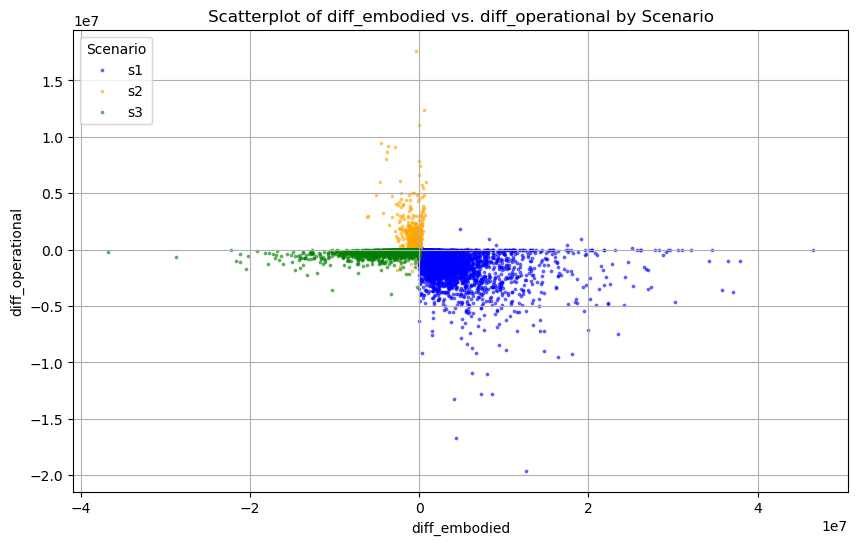

In [49]:
# Melt the DataFrame to have 'scenario' and 'value' columns for easier plotting
df_melted = pd.melt(
    df,
    id_vars=['bu_code'],
    value_vars=['diff_embodied_s1', 'diff_embodied_s2', 'diff_embodied_s3',
                'diff_operational_s1', 'diff_operational_s2', 'diff_operational_s3',
                'diff_total_s1', 'diff_total_s2', 'diff_total_s3'],
    var_name='metric_scenario',
    value_name='value'
)

# Extract metric and scenario information
df_melted['metric'] = df_melted['metric_scenario'].str.split('_').str[1]
df_melted['scenario'] = df_melted['metric_scenario'].str.split('_').str[-1]

# Pivot back to get separate columns for diff_embodied, diff_operational, and diff_total
df_pivoted = df_melted.pivot_table(
    index=['bu_code', 'scenario'],
    columns='metric',
    values='value'
).reset_index()

# Create a new column for marker shape based on diff_total
df_pivoted['marker'] = df_pivoted['total'].apply(lambda x: 'positive' if x > 0 else 'negative')

# Create the scatterplot
plt.figure(figsize=(10, 6))

# Define a single marker shape and colormap for scenarios
marker_shape = 'o'  # Single marker shape for all points
color_map = {'s1': 'blue', 's2': 'orange', 's3': 'green'}

for scenario in df_pivoted['scenario'].unique():
    subset = df_pivoted[df_pivoted['scenario'] == scenario]
    
    # Scatterplot
    plt.scatter(
        subset['embodied'],
        subset['operational'],
        color=color_map[scenario],  # Use the color for the scenario
        alpha=0.5,
        marker=marker_shape, s=3, 
        label=scenario
    )

# Customize plot
plt.xlabel('diff_embodied')
plt.ylabel('diff_operational')
plt.title('Scatterplot of diff_embodied vs. diff_operational by Scenario')
plt.legend(title='Scenario', loc='upper left')
plt.grid(True)
plt.show()

In [50]:
# Reshape the DataFrame into a long format
df_long = df_perBuurtPerYear.melt(
    id_vars=["year"], 
    value_vars=[
        "operational_kg_s0", "operational_kg_s1", "operational_kg_s2", "operational_kg_s3",
        "embodied_kg_s0", "embodied_kg_s1", "embodied_kg_s2", "embodied_kg_s3",
        "total_kg_s0", "total_kg_s1", "total_kg_s2", "total_kg_s3"
    ],
    var_name="type_scenario",
    value_name="emissions_kg"
)

# Split the 'type_scenario' column into 'type' and 'scenario'
df_long[["type", "scenario"]] = df_long["type_scenario"].str.split("_kg_", expand=True)

# Drop the original 'type_scenario' column
df_long = df_long.drop(columns=["type_scenario"])

# Rearrange the columns for clarity
df_long = df_long[["type", "scenario", "emissions_kg"]]
df_long = df_long.groupby(['scenario', 'type']).sum().reset_index()

In [51]:
df_long.sort_values(by=['type'], ascending=False, inplace=True) # to ensure that operational = blue and embodied = red
df_bar = df_long[df_long.type != 'total']
def change_scenario_name(x): 
    if x == 's0': return 'Baseline'
    if x == 's1': return 'Energy efficiency'
    if x == 's2': return 'Material efficiency'
    if x == 's3': return 'Space efficiency'
    return x
df_bar['scenario'] = df_bar['scenario'].map(change_scenario_name)

fig = px.bar(df_bar, x='scenario', y='emissions_kg', color='type', barmode='stack',
                title='Total emissions by scenario',
                labels={'emissions_kg': 'Total emissions (kg CO2e)', 'scenario': 'Scenario', 'type': 'Emission type'})
fig.update_layout(width=800)
fig.show()

/var/folders/r0/dcf480211ql6v50vx1qh0m080000gn/T/ipykernel_12070/2448627763.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [45]:
df = df_long[df_long.type == 'embodied']
s0 = df[df.scenario == 's0']['emissions_kg'].values[0]
s1 = df[df.scenario == 's1']['emissions_kg'].values[0]
s2 = df[df.scenario == 's2']['emissions_kg'].values[0]
s3 = df[df.scenario == 's3']['emissions_kg'].values[0]

print(f'% change in emissions for s1: {((s1 - s0) / s0) * 100}')
print(f'% change in emissions for s2: {((s2 - s0) / s0) * 100}')
print(f'% change in emissions for s3: {((s3 - s0) / s0) * 100}')

% change in emissions for s1: 66.31884364791533
% change in emissions for s2: -19.72173018585236
% change in emissions for s3: -29.295203679226063


### comparing material vs energy efficiency scenario

In [91]:
gdf = gdf_perBuurt.copy()
gdf_noData = gdf[gdf.diff_total_s1_pct.isna() | gdf.diff_total_s2_pct.isna()]
gdf = gdf.dropna(subset=['diff_total_s1', 'diff_total_s2'])
gdf['best_scenario'] = gdf[['diff_total_s1', 'diff_total_s2']].idxmin(axis=1)
def get_buurts_without_scenario(row): 
    if row.diff_total_s1 > 0 and row.diff_total_s2 > 0:
        return 'no scenario'
    else: 
        best_scenario = row.best_scenario
        return best_scenario
gdf['best_scenario'] = gdf.apply(lambda row: get_buurts_without_scenario(row), axis=1)   
gdf['best_scenario'] = gdf['best_scenario'].fillna('no data')
def scenario_name(x):
    if x == 'diff_total_s1':
        return 's1 - energy efficiency'
    elif x == 'diff_total_s2':
        return 's2 - material efficiency'
    else:
        return x
gdf['best_scenario'] = gdf.best_scenario.map(lambda x: scenario_name(x))

# gdf_allScenarios = gdf.copy()
# gdf_allScenarios['best_scenario'] = 'all scenarios'
# gdf = pd.concat([gdf, gdf_allScenarios])
# gdf.sort_values(by='best_scenario', inplace=True)
gdf = gdf[(gdf.diff_total_s2 < 7000000) & (gdf.diff_total_s2 > -40000000)]

In [92]:
gdf_pie = gdf[gdf.best_scenario != 'all scenarios'].copy()
color_map = {
    's1 - energy efficiency': '#7C85FB',
    's2 - material efficiency': '#EF553B'
}
fig = px.pie(gdf_pie, names='best_scenario', color='best_scenario', color_discrete_map=color_map, 
             title='Neighborhoods categorized by most beneficial scenario')
fig.update_layout(width=600)
fig.show()

In [108]:
fig = px.scatter(gdf_pie, x='diff_total_s1', y='diff_total_s2', color='best_scenario')
fig.update_traces(marker=dict(size=3))
fig.update_layout(height=600, width=800)
fig.show()

In [ ]:
gdf = gdf_perBuurt.copy()
gdf_noData = gdf[gdf.diff_total_s1_pct.isna() | gdf.diff_total_s2_pct.isna() | gdf.diff_total_s3_pct.isna()]
gdf = gdf.dropna(subset=['diff_total_s1', 'diff_total_s2', 'diff_total_s3'])
gdf['best_scenario'] = gdf[['diff_total_s1', 'diff_total_s2', 'diff_total_s3']].idxmin(axis=1)
gdf['best_scenario'] = gdf['best_scenario'].fillna('no data')
def scenario_name(x):
    if x == 'diff_total_s1':
        return 's1 - energy efficiency'
    elif x == 'diff_total_s2':
        return 's2 - material efficiency'
    elif x == 'diff_total_s3':
        return 's3 - space efficiency'
    else:
        return 'no data'
gdf['best_scenario'] = gdf.best_scenario.map(lambda x: scenario_name(x))

gdf_allScenarios = gdf.copy()
gdf_allScenarios['best_scenario'] = 'all scenarios'
gdf = pd.concat([gdf, gdf_allScenarios])
gdf.sort_values(by='best_scenario', inplace=True)
gdf = gdf[(gdf.diff_total_s2 < 7000000) & (gdf.diff_total_s2 > -40000000)]

In [ ]:
gdf_pie = gdf[gdf.best_scenario != 'all scenarios'].copy()
color_map = {
    's1 - energy efficiency': '#7C85FB',
    's2 - material efficiency': '#EF553B',
    's3 - space efficiency': '#00CC96'
}
fig = px.pie(gdf_pie, names='best_scenario', color='best_scenario', color_discrete_map=color_map, 
             title='Neighborhoods categorized by most beneficial scenario')
fig.update_layout(width=600)
fig.show()

In [ ]:
fig = px.scatter_3d(gdf_pie, x='diff_total_s1', y='diff_total_s2', z='diff_total_s3', color='best_scenario')
fig.update_traces(marker=dict(size=2))
fig.update_layout(height=1000, width=1000)
fig.show()

In [ ]:
gdf_pie.columns

# box plot of diff total by best_scenario
gdf_boxPlot = gdf_pie[['bu_code', 'best_scenario', 'diff_total_s1', 'diff_total_s2', 'diff_total_s3']].copy()
def getDiffTotal(row):
    scenario = row['best_scenario'][:2]
    diff_total = row[f'diff_total_{scenario}'] 
    return diff_total * -1
gdf_boxPlot['diff_total_bestScenario'] = gdf_boxPlot.apply(lambda row: getDiffTotal(row), axis=1) 

fig = px.box(gdf_boxPlot, x='best_scenario', y='diff_total_bestScenario', color='best_scenario', 
             title='Total emissions change by best scenario', 
             labels={'diff_total_bestScenario': 'Emissions savings (kg CO2e, log)', 'best_scenario': 'Best scenario'})
fig.update_layout(width=800)
fig.update_yaxes(type='log')
fig.show()

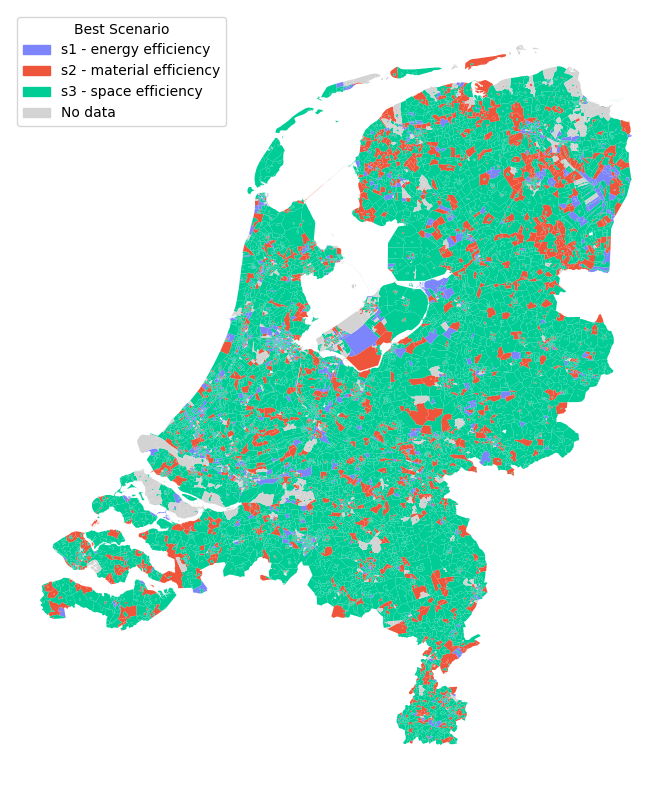

In [ ]:
gdf_map = gdf_pie.copy() 
color_map = {
    's1 - energy efficiency': '#7C85FB',
    's2 - material efficiency': '#EF553B',
    's3 - space efficiency': '#00CC96'
}
gdf_map['color'] = gdf_map['best_scenario'].map(color_map)

fig, ax = plt.subplots(1, 1, figsize=(15, 10))
gdf_map.plot(color=gdf_map['color'], ax=ax, legend=True, 
             legend_kwds={'loc': 'upper left'})
gdf_noData.plot(color='lightgrey', ax=ax)
ax.axis('off')

legend_patches = [mpatches.Patch(color=color, label=scenario) for scenario, color in color_map.items()]
legend_patches.append(mpatches.Patch(color='lightgrey', label='No data'))
ax.legend(handles=legend_patches, loc='upper left', title='Best Scenario')

plt.show()

In [98]:
# box plot of diff total by best_scenario
gdf_boxPlot = gdf_pie[['bu_code', 'best_scenario', 'diff_total_s1', 'diff_total_s2']].copy()
gdf_boxPlot = gdf_boxPlot[~gdf_boxPlot.best_scenario.isin(['no_data', 'no scenario'])]
def getDiffTotal(row):
    scenario = row['best_scenario'][:2]
    diff_total = row[f'diff_total_{scenario}'] 
    return diff_total * -1
gdf_boxPlot['diff_total_bestScenario'] = gdf_boxPlot.apply(lambda row: getDiffTotal(row), axis=1) 

fig = px.box(gdf_boxPlot, x='best_scenario', y='diff_total_bestScenario', color='best_scenario', 
             title='Total emissions savings by best scenario', 
             labels={'diff_total_bestScenario': 'Emissions savings (kg CO2e, log)', 'best_scenario': 'Best scenario'})
fig.update_layout(width=800)
fig.update_yaxes(type='log')
# fig.show()

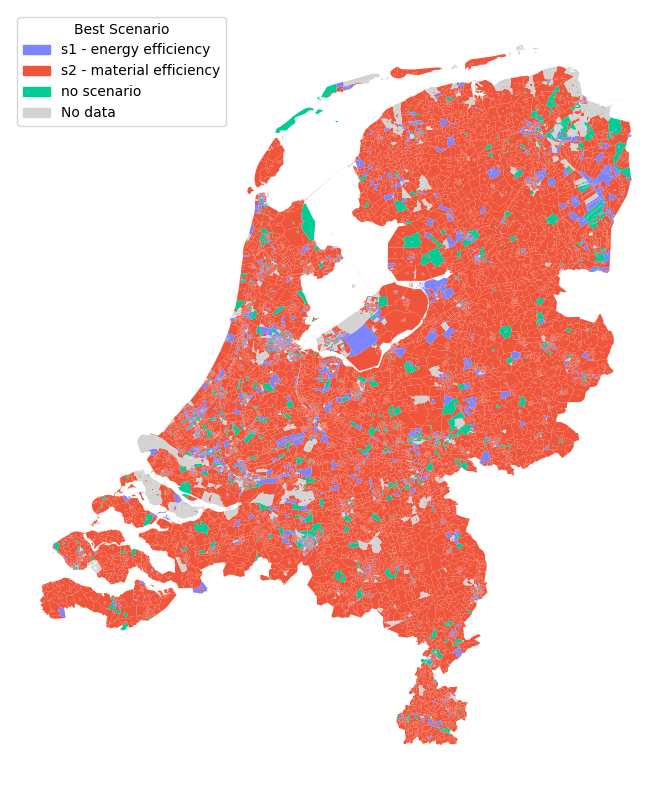

In [109]:
from shapely.geometry import box
from pyproj import Transformer
import matplotlib.patches as mpatches

# Define the bounding box in WGS84 (EPSG:4326)
bbox_wgs84 = box(4.5, 52.2, 5.1, 52.6)  # (minx, miny, maxx, maxy)

# Transform the bounding box to EPSG:28992
transformer = Transformer.from_crs("EPSG:4326", "EPSG:28992", always_xy=True)
minx, miny = transformer.transform(4.5, 52.2)  # Bottom-left corner
maxx, maxy = transformer.transform(5.1, 52.6)  # Top-right corner
bbox_rd = box(minx, miny, maxx, maxy)

# Filter the geometries within the transformed bounding box
gdf_map = gdf_pie.copy()
gdf_noData_map = gdf_noData.copy()
# gdf_map = gdf_map[gdf_map.intersects(bbox_rd)]
# gdf_noData_map = gdf_noData_map[gdf_noData_map.intersects(bbox_rd)]

color_map = {
    's1 - energy efficiency': '#7C85FB',
    's2 - material efficiency': '#EF553B',
    'no scenario': '#00CC96',
}
gdf_map['color'] = gdf_map['best_scenario'].map(color_map)

fig, ax = plt.subplots(1, 1, figsize=(15,10))
gdf_map.plot(color=gdf_map['color'], ax=ax, legend=True, 
             legend_kwds={'loc': 'upper left'})
gdf_noData_map.plot(color='lightgrey', ax=ax)
ax.axis('off')

legend_patches = [mpatches.Patch(color=color, label=scenario) for scenario, color in color_map.items()]
legend_patches.append(mpatches.Patch(color='lightgrey', label='No data'))
ax.legend(handles=legend_patches, loc='upper left', title='Best Scenario')

plt.show()

### Boxplots

- % sqm construction activity 
- total n new homes built per type 
- population density
- av. woz
- av. home size


In [174]:
gdf = gdf_perBuurt.copy()
gdf_noData = gdf[gdf.diff_total_s1_pct.isna() | gdf.diff_total_s2_pct.isna() | gdf.diff_total_s3_pct.isna()]
gdf = gdf.dropna(subset=['diff_total_s1', 'diff_total_s2', 'diff_total_s3'])
gdf['best_scenario'] = gdf[['diff_total_s1', 'diff_total_s2', 'diff_total_s3']].idxmin(axis=1)
gdf['best_scenario'] = gdf['best_scenario'].fillna('no data')
def scenario_name(x):
    if x == 'diff_total_s1':
        return 's1 - energy efficiency'
    elif x == 'diff_total_s2':
        return 's2 - material efficiency'
    elif x == 'diff_total_s3':
        return 's3 - space efficiency'
    else:
        return 'no data'
gdf['best_scenario'] = gdf.best_scenario.map(lambda x: scenario_name(x))

gdf_allScenarios = gdf.copy()
gdf_allScenarios['best_scenario'] = 'all scenarios'
gdf = pd.concat([gdf, gdf_allScenarios])
gdf.sort_values(by='best_scenario', inplace=True)
gdf = gdf[(gdf.diff_total_s2 < 7000000) & (gdf.diff_total_s2 > -40000000)]

In [179]:
gdf_pie = gdf[gdf.best_scenario != 'all scenarios'].copy()
color_map = {
    's1 - energy efficiency': '#7C85FB',
    's2 - material efficiency': '#EF553B',
    's3 - space efficiency': '#00CC96'
}
fig = px.pie(gdf_pie, names='best_scenario', color='best_scenario', color_discrete_map=color_map, 
             title='Neighborhoods categorized by most beneficial scenario')
fig.update_layout(width=600)
fig.show()

In [136]:
fig = px.scatter_3d(gdf_pie, x='diff_total_s1', y='diff_total_s2', z='diff_total_s3', color='best_scenario')
fig.update_traces(marker=dict(size=2))
fig.update_layout(height=1000, width=1000)
fig.show()

In [159]:
gdf_pie.columns

# box plot of diff total by best_scenario
gdf_boxPlot = gdf_pie[['bu_code', 'best_scenario', 'diff_total_s1', 'diff_total_s2', 'diff_total_s3']].copy()
def getDiffTotal(row):
    scenario = row['best_scenario'][:2]
    diff_total = row[f'diff_total_{scenario}'] 
    return diff_total * -1
gdf_boxPlot['diff_total_bestScenario'] = gdf_boxPlot.apply(lambda row: getDiffTotal(row), axis=1) 

fig = px.box(gdf_boxPlot, x='best_scenario', y='diff_total_bestScenario', color='best_scenario', 
             title='Total emissions change by best scenario', 
             labels={'diff_total_bestScenario': 'Emissions savings (kg CO2e, log)', 'best_scenario': 'Best scenario'})
fig.update_layout(width=800)
fig.update_yaxes(type='log')
fig.show()

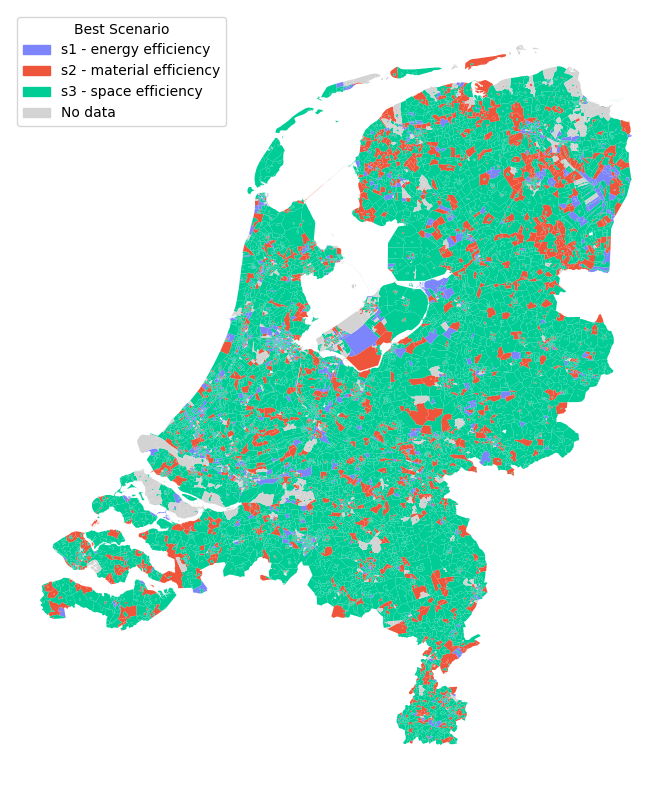

In [169]:
gdf_map = gdf_pie.copy() 
color_map = {
    's1 - energy efficiency': '#7C85FB',
    's2 - material efficiency': '#EF553B',
    's3 - space efficiency': '#00CC96'
}
gdf_map['color'] = gdf_map['best_scenario'].map(color_map)

fig, ax = plt.subplots(1, 1, figsize=(15, 10))
gdf_map.plot(color=gdf_map['color'], ax=ax, legend=True, 
             legend_kwds={'loc': 'upper left'})
gdf_noData.plot(color='lightgrey', ax=ax)
ax.axis('off')

legend_patches = [mpatches.Patch(color=color, label=scenario) for scenario, color in color_map.items()]
legend_patches.append(mpatches.Patch(color='lightgrey', label='No data'))
ax.legend(handles=legend_patches, loc='upper left', title='Best Scenario')

plt.show()

In [108]:
import plotly.express as px
import pandas as pd

# Select the relevant columns for the boxplot
activity_columns = ['av_p_construction', 'av_p_renovation', 'av_p_transformation', 'av_p_demolition']

# Melt the GeoDataFrame into a long format for easier plotting
gdf_long = gdf.melt(
    id_vars=['best_scenario'], 
    value_vars=activity_columns,
    var_name='activity_type',
    value_name='percentage'
)

# Function to remove outliers based on IQR
def remove_outliers(df, value_col):
    Q1 = df[value_col].quantile(0.25)
    Q3 = df[value_col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[value_col] >= lower_bound) & (df[value_col] <= upper_bound)]

# Apply outlier removal for each activity type
filtered_data = gdf_long.groupby('activity_type', group_keys=False).apply(
    lambda group: remove_outliers(group, 'percentage')
).sort_values(by='best_scenario')

def symmetric_log(x, base=10):
    return np.sign(x) * np.log1p(np.abs(x)) / np.log(base)
gdf_long['percentage_log'] = gdf_long['percentage'].apply(symmetric_log)

# Create the boxplot without outliers
fig = px.box(
    gdf_long,
    x='activity_type',
    y='percentage_log',
    color='best_scenario',
    title='Boxplot of Activity Types by Best Scenario (log scale)',
    labels={'activity_type': 'Activity Type', 'percentage': 'Percentage'},
    # points=False
)

# Show the plot
fig.update_layout(width=800)
fig.show()

/var/folders/r0/dcf480211ql6v50vx1qh0m080000gn/T/ipykernel_72352/4186747889.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [99]:
# n_new_homes
import numpy as np
def symmetric_log(x, base=10):
    return np.sign(x) * np.log1p(np.abs(x)) / np.log(base)
gdf['percentage_log'] = symmetric_log(gdf['n_new_homes'])
fig = px.box(gdf, x='best_scenario', y='percentage_log', color='best_scenario', title='Boxplot of n_new_homes by Best Scenario (log)')
fig.update_layout(width=1000)
fig.show()

# av_population_density
fig = px.box(gdf, x='best_scenario', y='av_population_density', color='best_scenario', title='Boxplot of av_population_density by Best Scenario')
fig.update_layout(width=1000)
fig.show()

# av_woz
fig = px.box(gdf, x='best_scenario', y='av_woz', color='best_scenario', title='Boxplot of av_woz by Best Scenario')
fig.update_layout(width=1000)
fig.show()

# av_home_size
def symmetric_log(x, base=10):
    return np.sign(x) * np.log1p(np.abs(x)) / np.log(base)
gdf['av_home_size_log'] = symmetric_log(gdf['av_home_size'])
fig = px.box(gdf, x='best_scenario', y='av_home_size_log', color='best_scenario', title='Boxplot of av_home_size by Best Scenario (log)')
fig.update_layout(width=1000)
fig.show()



### 3D plots

In [111]:
import numpy as np

gdf = gdf_perBuurt.copy()

# Define conditions for all possible categories
conditions = [
    (gdf['diff_total_s1'] > 0) & (gdf['diff_total_s2'] > 0) & (gdf['diff_total_s3'] > 0),
    (gdf['diff_total_s1'] > 0) & (gdf['diff_total_s2'] > 0) & (gdf['diff_total_s3'] <= 0),
    (gdf['diff_total_s1'] > 0) & (gdf['diff_total_s2'] <= 0) & (gdf['diff_total_s3'] > 0),
    (gdf['diff_total_s1'] > 0) & (gdf['diff_total_s2'] <= 0) & (gdf['diff_total_s3'] <= 0),
    (gdf['diff_total_s1'] <= 0) & (gdf['diff_total_s2'] > 0) & (gdf['diff_total_s3'] > 0),
    (gdf['diff_total_s1'] <= 0) & (gdf['diff_total_s2'] > 0) & (gdf['diff_total_s3'] <= 0),
    (gdf['diff_total_s1'] <= 0) & (gdf['diff_total_s2'] <= 0) & (gdf['diff_total_s3'] > 0),
    (gdf['diff_total_s1'] <= 0) & (gdf['diff_total_s2'] <= 0) & (gdf['diff_total_s3'] <= 0),
]

# Define corresponding category labels
categories = [
    'none',
    'only space',
    'only materials',
    'space, materials',
    'only energy',
    'space, energy',
    'energy, materials',
    'space, materials, energy',
]

# Assign categories using numpy.select
gdf['category'] = np.select(conditions, categories, default='no data')
gdf = gdf[(gdf.category != 'no data') & (gdf.category != 'none') & (gdf.category != 'only energy')]

In [112]:
# plotly pie chart for gdf categories
fig = px.pie(gdf, names='category', title='Categories of emissions changes for neighborhoods')
fig.update_layout(width=800)
fig.show()

In [34]:
fig = px.scatter_3d(gdf, x='diff_total_s1', y='diff_total_s2', z='diff_total_s3', color='category')
fig.update_traces(marker=dict(size=5))
fig.update_layout(height=1000, width=1000)
fig.show()

<Axes: >

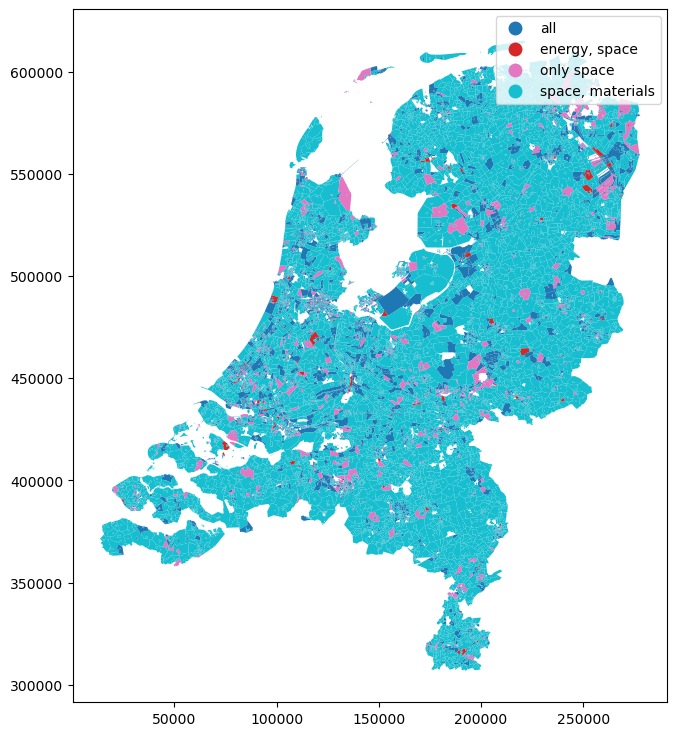

In [35]:
gdf.plot(column='category', legend=True, figsize=(15, 9))

/var/folders/r0/dcf480211ql6v50vx1qh0m080000gn/T/ipykernel_64188/1635872968.py:3: FutureWarning:

The behavior of DataFrame.idxmin with all-NA values, or any-NA and skipna=False, is deprecated. In a future version this will raise ValueError



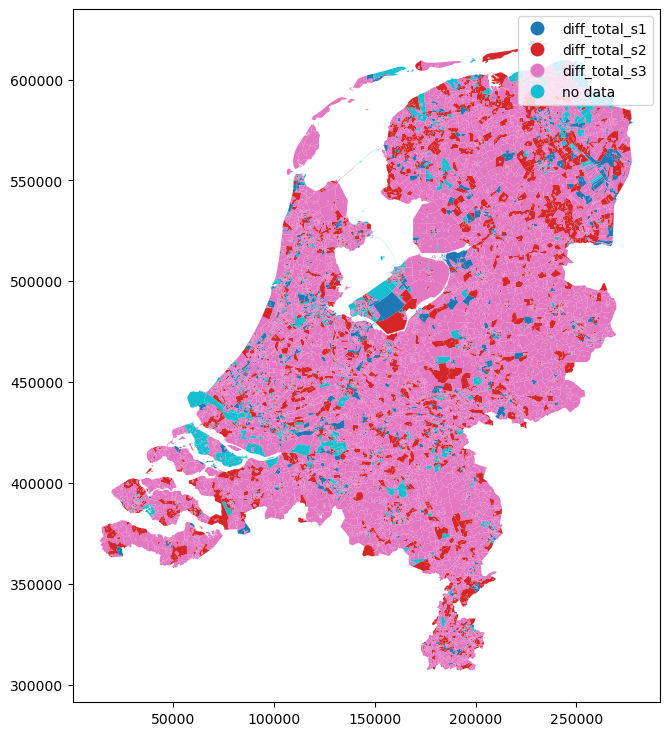

In [65]:
gdf['best_scenario'] = gdf[['diff_total_s1', 'diff_total_s2', 'diff_total_s3']].idxmin(axis=1, skipna=False)
gdf['best_scenario'] = gdf['best_scenario'].fillna('no data')
fig, ax = plt.subplots(figsize=(15, 9))
gdf.plot(column='best_scenario', legend=True, ax=ax)
# gdf[gdf.best_scenario.isna()].plot(ax=ax, color='grey', alpha=0.5)
plt.show()

In [66]:
gdf.columns

Index(['municipality', 'bu_code', 'bu_geom', 'embodied_kg_s0',
       'embodied_kg_s1', 'embodied_kg_s2', 'embodied_kg_s3',
       'diff_embodied_s1', 'diff_embodied_s2', 'diff_embodied_s3',
       'diff_embodied_s1_pct', 'diff_embodied_s2_pct', 'diff_embodied_s3_pct',
       'operational_kg_s0', 'operational_kg_s1', 'operational_kg_s2',
       'operational_kg_s3', 'diff_operational_s1', 'diff_operational_s2',
       'diff_operational_s3', 'diff_operational_s1_pct',
       'diff_operational_s2_pct', 'diff_operational_s3_pct', 'total_kg_s0',
       'total_kg_s1', 'total_kg_s2', 'total_kg_s3', 'diff_total_s1',
       'diff_total_s2', 'diff_total_s3', 'diff_total_s1_pct',
       'diff_total_s2_pct', 'diff_total_s3_pct', 'av_population', 'av_n_homes',
       'category', 'best_scenario'],
      dtype='object')